In [8]:
# !pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121

# !pip install matplotlib numpy

In [1]:
!python --version

Python 3.9.21


In [1]:
import torch
torch.__version__

'2.5.1'

In [2]:
torch.cuda.get_device_name(0)

'NVIDIA GeForce RTX 4060 Laptop GPU'

In [12]:
# Dataset download link:  https://drive.google.com/uc?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM

In [3]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class CelebADataset(Dataset):
    def __init__(self, root_dir, transform=None):
        """
        Args:
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.root_dir = root_dir
        self.transform = transform
        
        # Get all image file paths from the directory
        self.image_paths = [os.path.join(root_dir, img) for img in os.listdir(root_dir) if img.endswith('.jpg')]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Load image
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('RGB')
        
        # Apply the transform if provided
        if self.transform:
            image = self.transform(image)
        
        return image


In [5]:
# Define transformations (resize, crop, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize(64),  # Resize images to 64x64
    transforms.CenterCrop(64),  # Crop center to 64x64
    transforms.ToTensor(),  # Convert images to tensor
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Normalize to [-1, 1]
])

# Load CelebA dataset from the specified directory
dataset_path = '/home/ahmad10raza/Documents/TutorialHaven/AI & ML/Generative-AI/03_Working_With_GANs/img_align_celeba'
dataset = CelebADataset(root_dir=dataset_path, transform=transform)

# Create DataLoader
dataloader = DataLoader(dataset, batch_size=128, shuffle=True)

# Check how many images are loaded
print(f"Total number of images loaded: {len(dataset)}")


Total number of images loaded: 202599


# Explanation of the Generator Class in a GAN

## Objective
This code defines the Generator component of a Generative Adversarial Network (GAN). The Generator's purpose is to create realistic-looking fake images from random noise vectors (latent space representations). It learns to generate increasingly convincing images through adversarial training against the Discriminator.

## Code Breakdown

### Class Definition
```python
class Generator(nn.Module):
```
- Defines a neural network class that inherits from PyTorch's `nn.Module` base class
- This is the standard way to create custom neural networks in PyTorch

### Constructor (`__init__` method)
```python
def __init__(self, z_dim=100, img_channels=3):
    super(Generator, self).__init__()
```
- `z_dim`: Dimension of the input noise vector (default: 100)
- `img_channels`: Number of channels in output image (3 for RGB, 1 for grayscale)
- Calls parent class (`nn.Module`) constructor to properly initialize the module

### Neural Network Architecture
```python
self.model = nn.Sequential(
    nn.Linear(z_dim, 256),
    nn.ReLU(True),
    nn.Linear(256, 512),
    nn.ReLU(True),
    nn.Linear(512, 1024),
    nn.ReLU(True),
    nn.Linear(1024, img_channels * 64 * 64),
    nn.Tanh()
)
```
Defines a sequential model with these layers:
1. `nn.Linear(z_dim, 256)`: Fully connected layer that expands 100-dim noise to 256-dim
2. `nn.ReLU(True)`: ReLU activation (with inplace=True to save memory)
3. `nn.Linear(256, 512)`: Expands to 512-dim
4. Another ReLU activation
5. `nn.Linear(512, 1024)`: Expands to 1024-dim
6. Another ReLU activation
7. `nn.Linear(1024, img_channels * 64 * 64)`: Final layer that outputs enough values to form an image (3x64x64 for RGB)
8. `nn.Tanh()`: Tanh activation scales outputs to [-1, 1] range (common for GAN generators)

### Forward Pass
```python
def forward(self, z):
    img = self.model(z)
    img = img.view(img.size(0), 3, 64, 64)  # Reshape to image format
    return img
```
- Takes noise vector `z` as input
- Passes through the sequential model
- Reshapes the flat output tensor into an image format: (batch_size, channels, height, width)
- Returns the generated image

## Key Characteristics
1. **Progressive Expansion**: The network gradually expands the noise vector into an image-sized output
2. **Activation Choices**: ReLU for hidden layers (helps with gradient flow), Tanh for output (bounds pixel values)
3. **Fully Connected**: This is a simple generator using only linear layers (no convolutions)
4. **Output Size**: Generates 64x64 RGB images (common for many GAN applications)

This generator would typically be paired with a discriminator in an adversarial training setup, where the generator learns to produce increasingly realistic images that can fool the discriminator.

# Explanation of the Discriminator Class in a GAN

## Objective
This code defines the Discriminator component of a Generative Adversarial Network (GAN). The Discriminator's purpose is to distinguish between real images (from the training dataset) and fake images (generated by the Generator). It outputs a probability (0 to 1) indicating whether it believes an input image is real (close to 1) or fake (close to 0).

## Code Breakdown

### Class Definition
```python
class Discriminator(nn.Module):
```
- Defines a neural network class that inherits from PyTorch's `nn.Module`
- This is the standard way to create custom neural networks in PyTorch

### Constructor (`__init__` method)
```python
def __init__(self, img_channels=3):
    super(Discriminator, self).__init__()
```
- `img_channels`: Number of channels in input image (3 for RGB, 1 for grayscale)
- Calls parent class (`nn.Module`) constructor to properly initialize the module

### Neural Network Architecture
```python
self.model = nn.Sequential(
    nn.Flatten(),
    nn.Linear(img_channels * 64 * 64, 1024),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Linear(1024, 512),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Linear(512, 256),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Linear(256, 1),
    nn.Sigmoid()
)
```
Defines a sequential model with these layers:
1. `nn.Flatten()`: Flattens the input image (3x64x64) into a 1D vector (12288 elements)
2. `nn.Linear(img_channels * 64 * 64, 1024)`: First fully connected layer
3. `nn.LeakyReLU(0.2, inplace=True)`: LeakyReLU activation with negative slope=0.2
4. `nn.Linear(1024, 512)`: Reduces dimension to 512
5. Another LeakyReLU activation
6. `nn.Linear(512, 256)`: Reduces dimension to 256
7. Another LeakyReLU activation
8. `nn.Linear(256, 1)`: Final layer outputs a single value
9. `nn.Sigmoid()`: Sigmoid activation converts output to probability (0 to 1)

### Forward Pass
```python
def forward(self, img):
    return self.model(img)
```
- Takes an image tensor as input (either real or generated)
- Passes it through the sequential model
- Returns a single probability value between 0 and 1

## Key Characteristics

1. **Binary Classifier**: Designed to output a single probability score
2. **Progressive Compression**: Network gradually reduces dimensionality from image size to single value
3. **Activation Choices**:
   - LeakyReLU (slope=0.2) helps prevent dying ReLU problem in discriminators
   - Sigmoid on final layer for probability output
4. **Fully Connected**: Like the generator, this uses only linear layers (no convolutions)
5. **Symmetric Architecture**: Notice how the discriminator's layers mirror the generator's but in reverse (1024→512→256 vs 256→512→1024)

## Training Dynamics
During GAN training:
1. The discriminator learns to better distinguish real vs fake images
2. The generator learns to produce images that the discriminator classifies as real
3. This adversarial process continues until equilibrium is reached (in theory)

The discriminator's accuracy provides the training signal that drives the generator's improvement.

[Epoch 0/100] [Batch 0/1583] [D loss: 0.6909828186035156] [G loss: 0.7009307146072388]
[Epoch 0/100] [Batch 50/1583] [D loss: 0.2569158971309662] [G loss: 1.060478925704956]
[Epoch 0/100] [Batch 100/1583] [D loss: 0.14474661648273468] [G loss: 2.1952626705169678]
[Epoch 0/100] [Batch 150/1583] [D loss: 0.40623512864112854] [G loss: 1.154120922088623]
[Epoch 0/100] [Batch 200/1583] [D loss: 0.4830845594406128] [G loss: 0.5273627042770386]
[Epoch 0/100] [Batch 250/1583] [D loss: 0.4222307801246643] [G loss: 0.8194897770881653]
[Epoch 0/100] [Batch 300/1583] [D loss: 0.1855492740869522] [G loss: 2.411665678024292]
[Epoch 0/100] [Batch 350/1583] [D loss: 0.17018237709999084] [G loss: 2.4363064765930176]
[Epoch 0/100] [Batch 400/1583] [D loss: 0.1244465559720993] [G loss: 3.771688461303711]
[Epoch 0/100] [Batch 450/1583] [D loss: 0.03705098479986191] [G loss: 4.679120063781738]
[Epoch 0/100] [Batch 500/1583] [D loss: 0.12444581091403961] [G loss: 2.307615041732788]
[Epoch 0/100] [Batch 550/

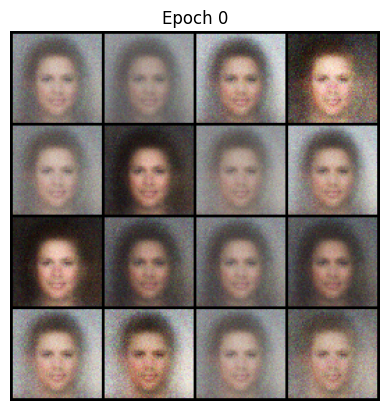

[Epoch 1/100] [Batch 0/1583] [D loss: 0.18909576535224915] [G loss: 2.513392925262451]
[Epoch 1/100] [Batch 50/1583] [D loss: 0.21174050867557526] [G loss: 3.0599489212036133]
[Epoch 1/100] [Batch 100/1583] [D loss: 0.1817060261964798] [G loss: 3.126783609390259]
[Epoch 1/100] [Batch 150/1583] [D loss: 0.22125014662742615] [G loss: 2.966508388519287]
[Epoch 1/100] [Batch 200/1583] [D loss: 0.24015939235687256] [G loss: 2.4844117164611816]
[Epoch 1/100] [Batch 250/1583] [D loss: 0.270151823759079] [G loss: 3.3030195236206055]
[Epoch 1/100] [Batch 300/1583] [D loss: 0.25638267397880554] [G loss: 2.269839286804199]
[Epoch 1/100] [Batch 350/1583] [D loss: 0.3400452435016632] [G loss: 2.9406399726867676]
[Epoch 1/100] [Batch 400/1583] [D loss: 0.2512109875679016] [G loss: 2.90000057220459]
[Epoch 1/100] [Batch 450/1583] [D loss: 0.23642009496688843] [G loss: 2.975321054458618]
[Epoch 1/100] [Batch 500/1583] [D loss: 0.17397040128707886] [G loss: 2.8354134559631348]
[Epoch 1/100] [Batch 550/

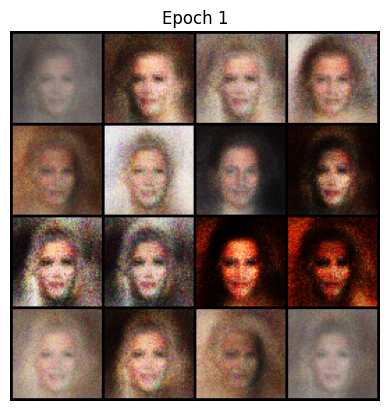

[Epoch 2/100] [Batch 0/1583] [D loss: 0.3611535429954529] [G loss: 3.748680353164673]
[Epoch 2/100] [Batch 50/1583] [D loss: 0.4696694314479828] [G loss: 1.6907107830047607]
[Epoch 2/100] [Batch 100/1583] [D loss: 0.48140066862106323] [G loss: 4.860714912414551]
[Epoch 2/100] [Batch 150/1583] [D loss: 0.21828822791576385] [G loss: 5.0308332443237305]
[Epoch 2/100] [Batch 200/1583] [D loss: 0.3041521906852722] [G loss: 2.222573757171631]
[Epoch 2/100] [Batch 250/1583] [D loss: 0.34562116861343384] [G loss: 2.580824375152588]
[Epoch 2/100] [Batch 300/1583] [D loss: 0.4233957529067993] [G loss: 2.2259597778320312]
[Epoch 2/100] [Batch 350/1583] [D loss: 0.28000468015670776] [G loss: 2.3531668186187744]
[Epoch 2/100] [Batch 400/1583] [D loss: 0.3843008577823639] [G loss: 2.159716844558716]
[Epoch 2/100] [Batch 450/1583] [D loss: 0.30461573600769043] [G loss: 2.106975555419922]
[Epoch 2/100] [Batch 500/1583] [D loss: 0.34987664222717285] [G loss: 3.256107807159424]
[Epoch 2/100] [Batch 550/

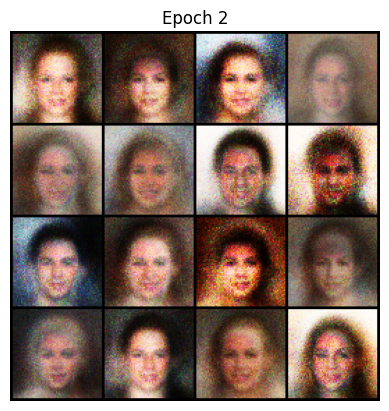

[Epoch 3/100] [Batch 0/1583] [D loss: 0.40173304080963135] [G loss: 2.4845967292785645]
[Epoch 3/100] [Batch 50/1583] [D loss: 0.4445187449455261] [G loss: 2.1092026233673096]
[Epoch 3/100] [Batch 100/1583] [D loss: 0.4879530072212219] [G loss: 1.7869935035705566]
[Epoch 3/100] [Batch 150/1583] [D loss: 0.393252968788147] [G loss: 2.2374582290649414]
[Epoch 3/100] [Batch 200/1583] [D loss: 0.41131138801574707] [G loss: 2.421973466873169]
[Epoch 3/100] [Batch 250/1583] [D loss: 0.36553820967674255] [G loss: 2.6221864223480225]
[Epoch 3/100] [Batch 300/1583] [D loss: 0.38647809624671936] [G loss: 2.330300807952881]
[Epoch 3/100] [Batch 350/1583] [D loss: 0.4970172643661499] [G loss: 1.6011860370635986]
[Epoch 3/100] [Batch 400/1583] [D loss: 0.48058056831359863] [G loss: 2.3372626304626465]
[Epoch 3/100] [Batch 450/1583] [D loss: 0.38982975482940674] [G loss: 2.372633457183838]
[Epoch 3/100] [Batch 500/1583] [D loss: 0.48573002219200134] [G loss: 1.9769361019134521]
[Epoch 3/100] [Batch 

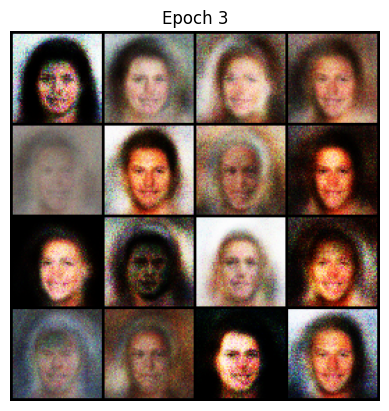

[Epoch 4/100] [Batch 0/1583] [D loss: 0.4877279996871948] [G loss: 1.9607303142547607]
[Epoch 4/100] [Batch 50/1583] [D loss: 0.4237733483314514] [G loss: 2.0842719078063965]
[Epoch 4/100] [Batch 100/1583] [D loss: 0.4897996783256531] [G loss: 2.4133028984069824]
[Epoch 4/100] [Batch 150/1583] [D loss: 0.43718409538269043] [G loss: 1.9053845405578613]
[Epoch 4/100] [Batch 200/1583] [D loss: 0.42541438341140747] [G loss: 1.4267101287841797]
[Epoch 4/100] [Batch 250/1583] [D loss: 0.36555519700050354] [G loss: 1.746516466140747]
[Epoch 4/100] [Batch 300/1583] [D loss: 0.7062698006629944] [G loss: 1.9273004531860352]
[Epoch 4/100] [Batch 350/1583] [D loss: 0.5646507740020752] [G loss: 1.5789799690246582]
[Epoch 4/100] [Batch 400/1583] [D loss: 0.42613786458969116] [G loss: 1.6242475509643555]
[Epoch 4/100] [Batch 450/1583] [D loss: 0.4738113582134247] [G loss: 1.5829389095306396]
[Epoch 4/100] [Batch 500/1583] [D loss: 0.42721113562583923] [G loss: 1.5131618976593018]
[Epoch 4/100] [Batch

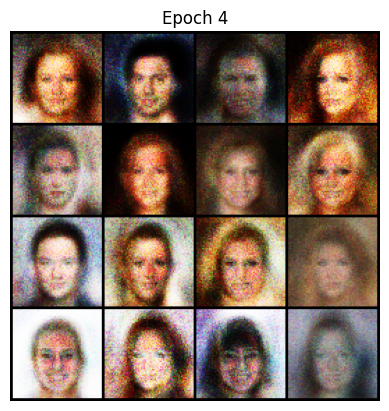

[Epoch 5/100] [Batch 0/1583] [D loss: 0.4889448285102844] [G loss: 1.7847718000411987]
[Epoch 5/100] [Batch 50/1583] [D loss: 0.4957307279109955] [G loss: 1.2066106796264648]
[Epoch 5/100] [Batch 100/1583] [D loss: 0.4381158649921417] [G loss: 1.5313668251037598]
[Epoch 5/100] [Batch 150/1583] [D loss: 0.41833457350730896] [G loss: 2.089264392852783]
[Epoch 5/100] [Batch 200/1583] [D loss: 0.4310530424118042] [G loss: 1.9416687488555908]
[Epoch 5/100] [Batch 250/1583] [D loss: 0.5083645582199097] [G loss: 1.3831229209899902]
[Epoch 5/100] [Batch 300/1583] [D loss: 0.5783935189247131] [G loss: 1.7971348762512207]
[Epoch 5/100] [Batch 350/1583] [D loss: 0.5271916389465332] [G loss: 1.7209644317626953]
[Epoch 5/100] [Batch 400/1583] [D loss: 0.4536992907524109] [G loss: 1.4699082374572754]
[Epoch 5/100] [Batch 450/1583] [D loss: 0.4013799726963043] [G loss: 1.5538647174835205]
[Epoch 5/100] [Batch 500/1583] [D loss: 0.5505880117416382] [G loss: 1.5141477584838867]
[Epoch 5/100] [Batch 550

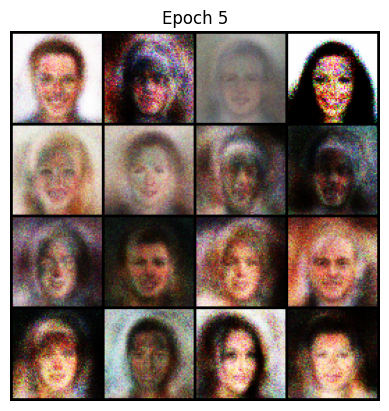

[Epoch 6/100] [Batch 0/1583] [D loss: 0.5261013507843018] [G loss: 1.2139644622802734]
[Epoch 6/100] [Batch 50/1583] [D loss: 0.40408772230148315] [G loss: 1.3792273998260498]
[Epoch 6/100] [Batch 100/1583] [D loss: 0.44607651233673096] [G loss: 1.597853660583496]
[Epoch 6/100] [Batch 150/1583] [D loss: 0.530588686466217] [G loss: 1.372697114944458]
[Epoch 6/100] [Batch 200/1583] [D loss: 0.5388969779014587] [G loss: 1.337327241897583]
[Epoch 6/100] [Batch 250/1583] [D loss: 0.4594786763191223] [G loss: 1.9736709594726562]
[Epoch 6/100] [Batch 300/1583] [D loss: 0.48429158329963684] [G loss: 1.4864468574523926]
[Epoch 6/100] [Batch 350/1583] [D loss: 0.5338255167007446] [G loss: 1.9706937074661255]
[Epoch 6/100] [Batch 400/1583] [D loss: 0.58568274974823] [G loss: 1.7673308849334717]
[Epoch 6/100] [Batch 450/1583] [D loss: 0.5522112250328064] [G loss: 1.5122287273406982]
[Epoch 6/100] [Batch 500/1583] [D loss: 0.5272539854049683] [G loss: 1.662960171699524]
[Epoch 6/100] [Batch 550/158

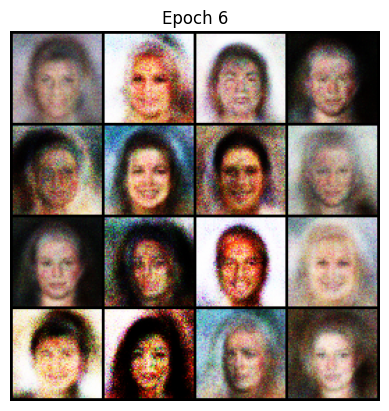

[Epoch 7/100] [Batch 0/1583] [D loss: 0.5613837242126465] [G loss: 1.670619249343872]
[Epoch 7/100] [Batch 50/1583] [D loss: 0.5509482622146606] [G loss: 1.475074291229248]
[Epoch 7/100] [Batch 100/1583] [D loss: 0.5020896196365356] [G loss: 1.5569400787353516]
[Epoch 7/100] [Batch 150/1583] [D loss: 0.4540635049343109] [G loss: 1.3658711910247803]
[Epoch 7/100] [Batch 200/1583] [D loss: 0.570683479309082] [G loss: 1.356440782546997]
[Epoch 7/100] [Batch 250/1583] [D loss: 0.5625118017196655] [G loss: 1.4161123037338257]
[Epoch 7/100] [Batch 300/1583] [D loss: 0.57254958152771] [G loss: 1.311301827430725]
[Epoch 7/100] [Batch 350/1583] [D loss: 0.4932458996772766] [G loss: 1.3360166549682617]
[Epoch 7/100] [Batch 400/1583] [D loss: 0.5146310925483704] [G loss: 1.5275459289550781]
[Epoch 7/100] [Batch 450/1583] [D loss: 0.49944379925727844] [G loss: 1.50325608253479]
[Epoch 7/100] [Batch 500/1583] [D loss: 0.5246942639350891] [G loss: 1.576387643814087]
[Epoch 7/100] [Batch 550/1583] [D

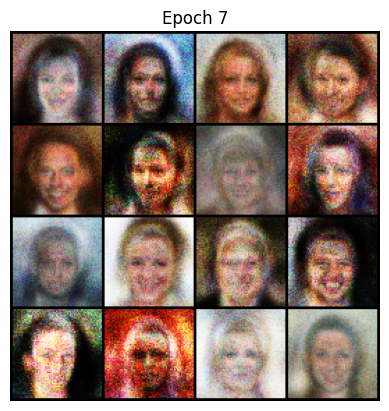

[Epoch 8/100] [Batch 0/1583] [D loss: 0.589860200881958] [G loss: 1.3241803646087646]
[Epoch 8/100] [Batch 50/1583] [D loss: 0.48856738209724426] [G loss: 1.5079519748687744]
[Epoch 8/100] [Batch 100/1583] [D loss: 0.5701139569282532] [G loss: 1.2880306243896484]
[Epoch 8/100] [Batch 150/1583] [D loss: 0.5068011283874512] [G loss: 1.264397382736206]
[Epoch 8/100] [Batch 200/1583] [D loss: 0.5969568490982056] [G loss: 1.214951753616333]
[Epoch 8/100] [Batch 250/1583] [D loss: 0.5285840034484863] [G loss: 1.520564317703247]
[Epoch 8/100] [Batch 300/1583] [D loss: 0.5561755895614624] [G loss: 1.3753392696380615]
[Epoch 8/100] [Batch 350/1583] [D loss: 0.5216909646987915] [G loss: 1.2880034446716309]
[Epoch 8/100] [Batch 400/1583] [D loss: 0.5776098966598511] [G loss: 1.1829050779342651]
[Epoch 8/100] [Batch 450/1583] [D loss: 0.47360217571258545] [G loss: 1.3463841676712036]
[Epoch 8/100] [Batch 500/1583] [D loss: 0.5405087471008301] [G loss: 1.1859506368637085]
[Epoch 8/100] [Batch 550/1

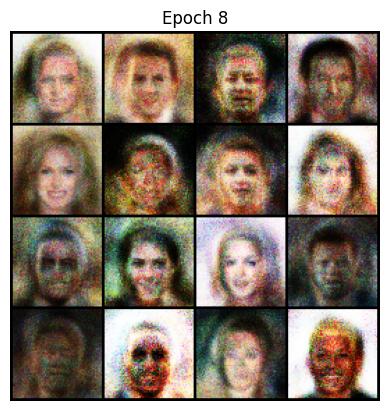

[Epoch 9/100] [Batch 0/1583] [D loss: 0.5700809955596924] [G loss: 1.4726752042770386]
[Epoch 9/100] [Batch 50/1583] [D loss: 0.5104281902313232] [G loss: 1.2569959163665771]
[Epoch 9/100] [Batch 100/1583] [D loss: 0.6583629846572876] [G loss: 1.1307499408721924]
[Epoch 9/100] [Batch 150/1583] [D loss: 0.5066952705383301] [G loss: 1.2987732887268066]
[Epoch 9/100] [Batch 200/1583] [D loss: 0.5902670621871948] [G loss: 1.1960570812225342]
[Epoch 9/100] [Batch 250/1583] [D loss: 0.5538607835769653] [G loss: 1.398987054824829]
[Epoch 9/100] [Batch 300/1583] [D loss: 0.5224733352661133] [G loss: 1.3513219356536865]
[Epoch 9/100] [Batch 350/1583] [D loss: 0.5622555017471313] [G loss: 1.1837327480316162]
[Epoch 9/100] [Batch 400/1583] [D loss: 0.49916794896125793] [G loss: 1.3565844297409058]
[Epoch 9/100] [Batch 450/1583] [D loss: 0.5280776023864746] [G loss: 1.3121975660324097]
[Epoch 9/100] [Batch 500/1583] [D loss: 0.5521501302719116] [G loss: 1.2140226364135742]
[Epoch 9/100] [Batch 550

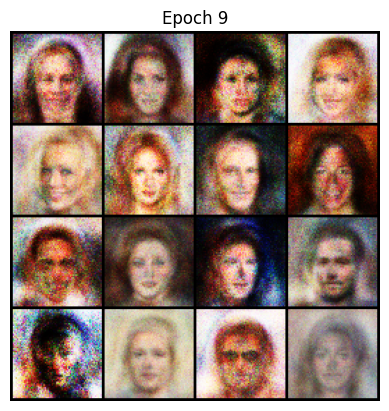

[Epoch 10/100] [Batch 0/1583] [D loss: 0.5944881439208984] [G loss: 1.1169548034667969]
[Epoch 10/100] [Batch 50/1583] [D loss: 0.5940503478050232] [G loss: 1.2617350816726685]
[Epoch 10/100] [Batch 100/1583] [D loss: 0.5079321265220642] [G loss: 1.256787657737732]
[Epoch 10/100] [Batch 150/1583] [D loss: 0.5798705816268921] [G loss: 1.1185516119003296]
[Epoch 10/100] [Batch 200/1583] [D loss: 0.5661730170249939] [G loss: 1.5644915103912354]
[Epoch 10/100] [Batch 250/1583] [D loss: 0.5835942029953003] [G loss: 1.3446478843688965]
[Epoch 10/100] [Batch 300/1583] [D loss: 0.5265037417411804] [G loss: 1.3043663501739502]
[Epoch 10/100] [Batch 350/1583] [D loss: 0.5650166273117065] [G loss: 1.3475971221923828]
[Epoch 10/100] [Batch 400/1583] [D loss: 0.5317310094833374] [G loss: 1.1284040212631226]
[Epoch 10/100] [Batch 450/1583] [D loss: 0.5743095874786377] [G loss: 1.278207778930664]
[Epoch 10/100] [Batch 500/1583] [D loss: 0.5388152599334717] [G loss: 1.2692724466323853]
[Epoch 10/100] 

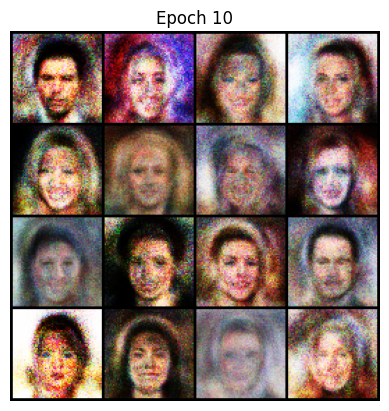

[Epoch 11/100] [Batch 0/1583] [D loss: 0.6142991781234741] [G loss: 1.342672348022461]
[Epoch 11/100] [Batch 50/1583] [D loss: 0.5744351148605347] [G loss: 1.2404148578643799]
[Epoch 11/100] [Batch 100/1583] [D loss: 0.5887192487716675] [G loss: 1.259960651397705]
[Epoch 11/100] [Batch 150/1583] [D loss: 0.5149345993995667] [G loss: 1.1587191820144653]
[Epoch 11/100] [Batch 200/1583] [D loss: 0.5815585255622864] [G loss: 1.2086950540542603]
[Epoch 11/100] [Batch 250/1583] [D loss: 0.5205971598625183] [G loss: 1.1647653579711914]
[Epoch 11/100] [Batch 300/1583] [D loss: 0.6093662977218628] [G loss: 1.397463321685791]
[Epoch 11/100] [Batch 350/1583] [D loss: 0.5870373249053955] [G loss: 1.2913498878479004]
[Epoch 11/100] [Batch 400/1583] [D loss: 0.6046276688575745] [G loss: 1.2357203960418701]
[Epoch 11/100] [Batch 450/1583] [D loss: 0.5116897821426392] [G loss: 1.260211706161499]
[Epoch 11/100] [Batch 500/1583] [D loss: 0.5688222646713257] [G loss: 1.2534712553024292]
[Epoch 11/100] [B

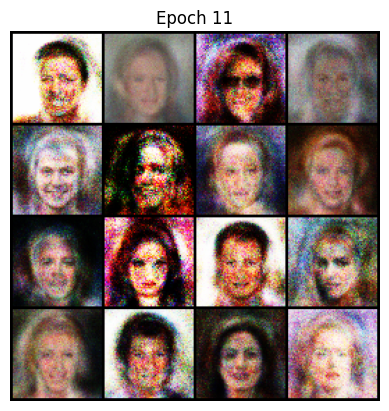

[Epoch 12/100] [Batch 0/1583] [D loss: 0.5822665691375732] [G loss: 1.2797915935516357]
[Epoch 12/100] [Batch 50/1583] [D loss: 0.6101769208908081] [G loss: 1.333659052848816]
[Epoch 12/100] [Batch 100/1583] [D loss: 0.5781439542770386] [G loss: 1.1675591468811035]
[Epoch 12/100] [Batch 150/1583] [D loss: 0.5546205043792725] [G loss: 1.2992489337921143]
[Epoch 12/100] [Batch 200/1583] [D loss: 0.6435632705688477] [G loss: 1.2505009174346924]
[Epoch 12/100] [Batch 250/1583] [D loss: 0.5407120585441589] [G loss: 1.3772711753845215]
[Epoch 12/100] [Batch 300/1583] [D loss: 0.5805120468139648] [G loss: 1.3009960651397705]
[Epoch 12/100] [Batch 350/1583] [D loss: 0.558638334274292] [G loss: 1.1864299774169922]
[Epoch 12/100] [Batch 400/1583] [D loss: 0.5784554481506348] [G loss: 1.0178523063659668]
[Epoch 12/100] [Batch 450/1583] [D loss: 0.5800998210906982] [G loss: 1.3198248147964478]
[Epoch 12/100] [Batch 500/1583] [D loss: 0.5832566022872925] [G loss: 0.9776223301887512]
[Epoch 12/100] 

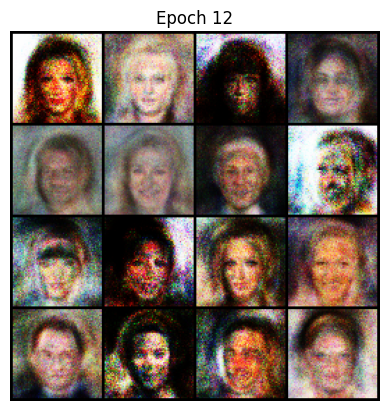

[Epoch 13/100] [Batch 0/1583] [D loss: 0.5764729380607605] [G loss: 1.0800127983093262]
[Epoch 13/100] [Batch 50/1583] [D loss: 0.5560702085494995] [G loss: 1.289353609085083]
[Epoch 13/100] [Batch 100/1583] [D loss: 0.6459119319915771] [G loss: 1.4522435665130615]
[Epoch 13/100] [Batch 150/1583] [D loss: 0.559354305267334] [G loss: 1.2099615335464478]
[Epoch 13/100] [Batch 200/1583] [D loss: 0.5421428680419922] [G loss: 1.1592875719070435]
[Epoch 13/100] [Batch 250/1583] [D loss: 0.5186817049980164] [G loss: 1.0979152917861938]
[Epoch 13/100] [Batch 300/1583] [D loss: 0.6236603260040283] [G loss: 1.04972243309021]
[Epoch 13/100] [Batch 350/1583] [D loss: 0.5537533760070801] [G loss: 1.293029546737671]
[Epoch 13/100] [Batch 400/1583] [D loss: 0.5618870854377747] [G loss: 1.0648597478866577]
[Epoch 13/100] [Batch 450/1583] [D loss: 0.6730594635009766] [G loss: 1.3139373064041138]
[Epoch 13/100] [Batch 500/1583] [D loss: 0.5305382609367371] [G loss: 1.0245928764343262]
[Epoch 13/100] [Ba

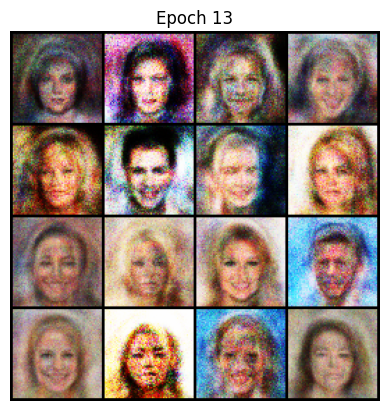

[Epoch 14/100] [Batch 0/1583] [D loss: 0.6100849509239197] [G loss: 1.2635226249694824]
[Epoch 14/100] [Batch 50/1583] [D loss: 0.5880377292633057] [G loss: 1.0680197477340698]
[Epoch 14/100] [Batch 100/1583] [D loss: 0.6084777116775513] [G loss: 1.3523838520050049]
[Epoch 14/100] [Batch 150/1583] [D loss: 0.5789186358451843] [G loss: 1.467061161994934]
[Epoch 14/100] [Batch 200/1583] [D loss: 0.5445880889892578] [G loss: 1.3238866329193115]
[Epoch 14/100] [Batch 250/1583] [D loss: 0.5165195465087891] [G loss: 1.2696056365966797]
[Epoch 14/100] [Batch 300/1583] [D loss: 0.5707940459251404] [G loss: 1.2830805778503418]
[Epoch 14/100] [Batch 350/1583] [D loss: 0.5418170690536499] [G loss: 1.153846025466919]
[Epoch 14/100] [Batch 400/1583] [D loss: 0.5993248224258423] [G loss: 1.2006728649139404]
[Epoch 14/100] [Batch 450/1583] [D loss: 0.5350990891456604] [G loss: 1.2959903478622437]
[Epoch 14/100] [Batch 500/1583] [D loss: 0.5323036909103394] [G loss: 1.1945276260375977]
[Epoch 14/100] 

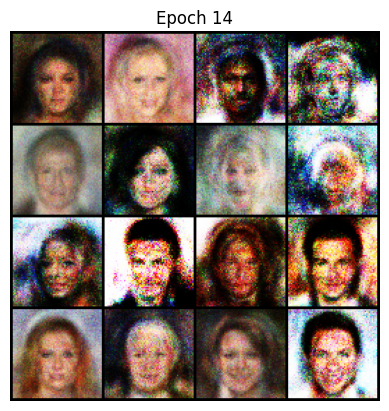

[Epoch 15/100] [Batch 0/1583] [D loss: 0.5751111507415771] [G loss: 1.1426151990890503]
[Epoch 15/100] [Batch 50/1583] [D loss: 0.580635666847229] [G loss: 1.194044589996338]
[Epoch 15/100] [Batch 100/1583] [D loss: 0.5827815532684326] [G loss: 1.1948719024658203]
[Epoch 15/100] [Batch 150/1583] [D loss: 0.5489920973777771] [G loss: 1.4693431854248047]
[Epoch 15/100] [Batch 200/1583] [D loss: 0.5809387564659119] [G loss: 1.178823709487915]
[Epoch 15/100] [Batch 250/1583] [D loss: 0.5624643564224243] [G loss: 1.0067057609558105]
[Epoch 15/100] [Batch 300/1583] [D loss: 0.5713344216346741] [G loss: 1.2501403093338013]
[Epoch 15/100] [Batch 350/1583] [D loss: 0.5465825200080872] [G loss: 1.0756995677947998]
[Epoch 15/100] [Batch 400/1583] [D loss: 0.5494381785392761] [G loss: 1.1251698732376099]
[Epoch 15/100] [Batch 450/1583] [D loss: 0.5779287219047546] [G loss: 1.0074236392974854]
[Epoch 15/100] [Batch 500/1583] [D loss: 0.587531566619873] [G loss: 1.1380035877227783]
[Epoch 15/100] [B

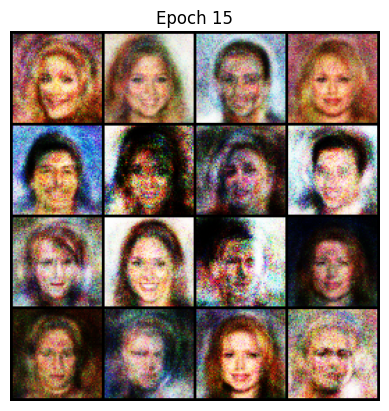

[Epoch 16/100] [Batch 0/1583] [D loss: 0.5218542218208313] [G loss: 1.0908455848693848]
[Epoch 16/100] [Batch 50/1583] [D loss: 0.552242636680603] [G loss: 1.2669923305511475]
[Epoch 16/100] [Batch 100/1583] [D loss: 0.5936501026153564] [G loss: 1.352522611618042]
[Epoch 16/100] [Batch 150/1583] [D loss: 0.6024794578552246] [G loss: 1.1714857816696167]
[Epoch 16/100] [Batch 200/1583] [D loss: 0.5513435006141663] [G loss: 1.1515209674835205]
[Epoch 16/100] [Batch 250/1583] [D loss: 0.5687955617904663] [G loss: 1.1719913482666016]
[Epoch 16/100] [Batch 300/1583] [D loss: 0.5856307744979858] [G loss: 1.1612727642059326]
[Epoch 16/100] [Batch 350/1583] [D loss: 0.5412124395370483] [G loss: 1.1821308135986328]
[Epoch 16/100] [Batch 400/1583] [D loss: 0.6004530191421509] [G loss: 1.198427438735962]
[Epoch 16/100] [Batch 450/1583] [D loss: 0.578994870185852] [G loss: 1.1079224348068237]
[Epoch 16/100] [Batch 500/1583] [D loss: 0.5473499298095703] [G loss: 1.1719229221343994]
[Epoch 16/100] [B

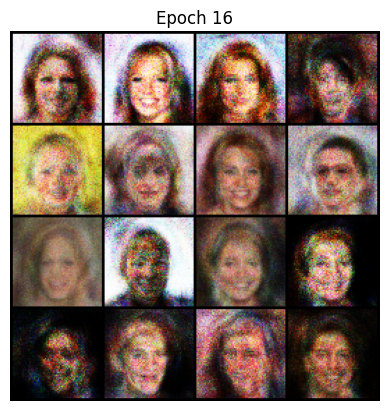

[Epoch 17/100] [Batch 0/1583] [D loss: 0.5110068321228027] [G loss: 1.0042052268981934]
[Epoch 17/100] [Batch 50/1583] [D loss: 0.5451306104660034] [G loss: 1.2992169857025146]
[Epoch 17/100] [Batch 100/1583] [D loss: 0.5896931886672974] [G loss: 1.3013107776641846]
[Epoch 17/100] [Batch 150/1583] [D loss: 0.5630055665969849] [G loss: 1.2610070705413818]
[Epoch 17/100] [Batch 200/1583] [D loss: 0.5842080116271973] [G loss: 1.065814733505249]
[Epoch 17/100] [Batch 250/1583] [D loss: 0.5513241291046143] [G loss: 1.148500919342041]
[Epoch 17/100] [Batch 300/1583] [D loss: 0.5661868453025818] [G loss: 1.3267972469329834]
[Epoch 17/100] [Batch 350/1583] [D loss: 0.5090261697769165] [G loss: 1.3242850303649902]
[Epoch 17/100] [Batch 400/1583] [D loss: 0.5941650867462158] [G loss: 1.0576307773590088]
[Epoch 17/100] [Batch 450/1583] [D loss: 0.5234969258308411] [G loss: 1.2780437469482422]
[Epoch 17/100] [Batch 500/1583] [D loss: 0.6094163656234741] [G loss: 1.2331295013427734]
[Epoch 17/100] 

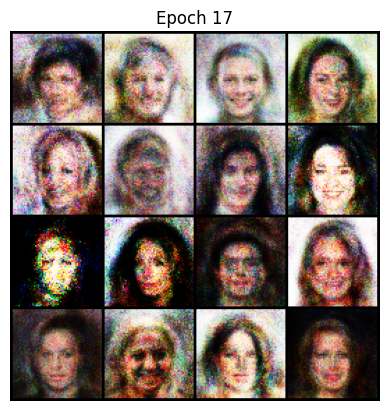

[Epoch 18/100] [Batch 0/1583] [D loss: 0.5688375234603882] [G loss: 1.2615876197814941]
[Epoch 18/100] [Batch 50/1583] [D loss: 0.5566962957382202] [G loss: 1.2271802425384521]
[Epoch 18/100] [Batch 100/1583] [D loss: 0.563172459602356] [G loss: 1.201575756072998]
[Epoch 18/100] [Batch 150/1583] [D loss: 0.5671259760856628] [G loss: 1.244737148284912]
[Epoch 18/100] [Batch 200/1583] [D loss: 0.5819366574287415] [G loss: 1.28568696975708]
[Epoch 18/100] [Batch 250/1583] [D loss: 0.5658928751945496] [G loss: 1.15646231174469]
[Epoch 18/100] [Batch 300/1583] [D loss: 0.639320433139801] [G loss: 1.3790009021759033]
[Epoch 18/100] [Batch 350/1583] [D loss: 0.5230980515480042] [G loss: 1.2562850713729858]
[Epoch 18/100] [Batch 400/1583] [D loss: 0.5499472618103027] [G loss: 1.1336064338684082]
[Epoch 18/100] [Batch 450/1583] [D loss: 0.538031816482544] [G loss: 1.185591459274292]
[Epoch 18/100] [Batch 500/1583] [D loss: 0.6525892615318298] [G loss: 1.2681376934051514]
[Epoch 18/100] [Batch 5

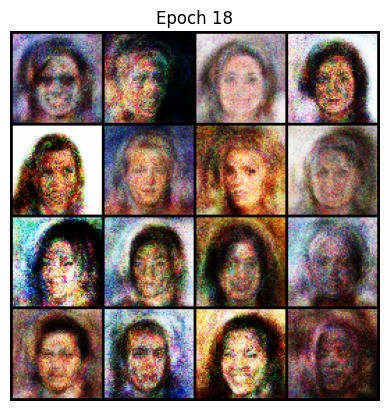

[Epoch 19/100] [Batch 0/1583] [D loss: 0.5446078777313232] [G loss: 1.2595607042312622]
[Epoch 19/100] [Batch 50/1583] [D loss: 0.5375815629959106] [G loss: 1.1137707233428955]
[Epoch 19/100] [Batch 100/1583] [D loss: 0.5353706479072571] [G loss: 1.0576212406158447]
[Epoch 19/100] [Batch 150/1583] [D loss: 0.5466430187225342] [G loss: 1.2440255880355835]
[Epoch 19/100] [Batch 200/1583] [D loss: 0.5683881640434265] [G loss: 1.2512272596359253]
[Epoch 19/100] [Batch 250/1583] [D loss: 0.5494425892829895] [G loss: 1.2646576166152954]
[Epoch 19/100] [Batch 300/1583] [D loss: 0.5207886099815369] [G loss: 1.2038424015045166]
[Epoch 19/100] [Batch 350/1583] [D loss: 0.5589921474456787] [G loss: 1.2177205085754395]
[Epoch 19/100] [Batch 400/1583] [D loss: 0.6352736949920654] [G loss: 1.161205530166626]
[Epoch 19/100] [Batch 450/1583] [D loss: 0.5594130158424377] [G loss: 1.1823170185089111]
[Epoch 19/100] [Batch 500/1583] [D loss: 0.6265779137611389] [G loss: 1.2611732482910156]
[Epoch 19/100]

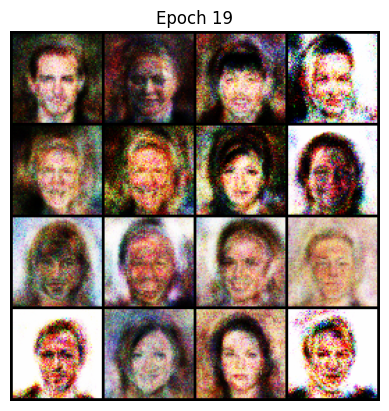

[Epoch 20/100] [Batch 0/1583] [D loss: 0.5294374823570251] [G loss: 1.3631864786148071]
[Epoch 20/100] [Batch 50/1583] [D loss: 0.6003471612930298] [G loss: 1.1763434410095215]
[Epoch 20/100] [Batch 100/1583] [D loss: 0.593392014503479] [G loss: 1.169245719909668]
[Epoch 20/100] [Batch 150/1583] [D loss: 0.5380080342292786] [G loss: 1.0884675979614258]
[Epoch 20/100] [Batch 200/1583] [D loss: 0.5042179822921753] [G loss: 1.3115100860595703]
[Epoch 20/100] [Batch 250/1583] [D loss: 0.5557701587677002] [G loss: 1.1400972604751587]
[Epoch 20/100] [Batch 300/1583] [D loss: 0.53733229637146] [G loss: 1.22233247756958]
[Epoch 20/100] [Batch 350/1583] [D loss: 0.5333213806152344] [G loss: 1.2462868690490723]
[Epoch 20/100] [Batch 400/1583] [D loss: 0.6391830444335938] [G loss: 1.0722931623458862]
[Epoch 20/100] [Batch 450/1583] [D loss: 0.565030574798584] [G loss: 1.2263553142547607]
[Epoch 20/100] [Batch 500/1583] [D loss: 0.5405575037002563] [G loss: 1.1550806760787964]
[Epoch 20/100] [Batc

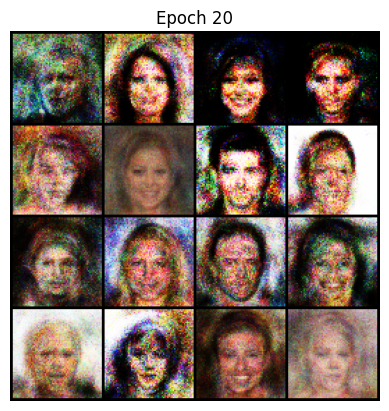

[Epoch 21/100] [Batch 0/1583] [D loss: 0.48883184790611267] [G loss: 1.4515931606292725]
[Epoch 21/100] [Batch 50/1583] [D loss: 0.5816178321838379] [G loss: 1.1074531078338623]
[Epoch 21/100] [Batch 100/1583] [D loss: 0.5764524936676025] [G loss: 1.113451361656189]
[Epoch 21/100] [Batch 150/1583] [D loss: 0.5536652207374573] [G loss: 1.268292784690857]
[Epoch 21/100] [Batch 200/1583] [D loss: 0.5543481111526489] [G loss: 1.3569351434707642]
[Epoch 21/100] [Batch 250/1583] [D loss: 0.5430202484130859] [G loss: 1.3505151271820068]
[Epoch 21/100] [Batch 300/1583] [D loss: 0.6188358068466187] [G loss: 1.2335267066955566]
[Epoch 21/100] [Batch 350/1583] [D loss: 0.50611412525177] [G loss: 1.2780520915985107]
[Epoch 21/100] [Batch 400/1583] [D loss: 0.5651187300682068] [G loss: 1.2308048009872437]
[Epoch 21/100] [Batch 450/1583] [D loss: 0.5676978826522827] [G loss: 1.436387062072754]
[Epoch 21/100] [Batch 500/1583] [D loss: 0.5101439952850342] [G loss: 1.213146448135376]
[Epoch 21/100] [Ba

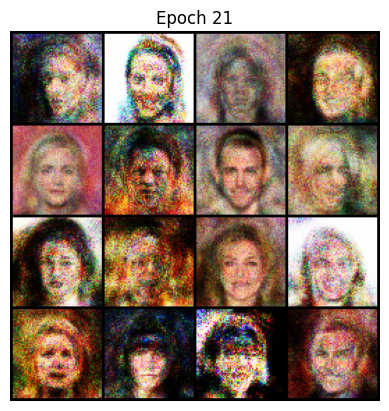

[Epoch 22/100] [Batch 0/1583] [D loss: 0.5854140520095825] [G loss: 1.3044754266738892]
[Epoch 22/100] [Batch 50/1583] [D loss: 0.5497896671295166] [G loss: 1.247528314590454]
[Epoch 22/100] [Batch 100/1583] [D loss: 0.5115088820457458] [G loss: 1.0752887725830078]
[Epoch 22/100] [Batch 150/1583] [D loss: 0.5715866088867188] [G loss: 1.2704836130142212]
[Epoch 22/100] [Batch 200/1583] [D loss: 0.5993180871009827] [G loss: 1.0932021141052246]
[Epoch 22/100] [Batch 250/1583] [D loss: 0.5627890229225159] [G loss: 1.137622594833374]
[Epoch 22/100] [Batch 300/1583] [D loss: 0.5543331503868103] [G loss: 1.273017406463623]
[Epoch 22/100] [Batch 350/1583] [D loss: 0.5252891182899475] [G loss: 1.4543921947479248]
[Epoch 22/100] [Batch 400/1583] [D loss: 0.5718613862991333] [G loss: 1.20340895652771]
[Epoch 22/100] [Batch 450/1583] [D loss: 0.5225864052772522] [G loss: 1.109631896018982]
[Epoch 22/100] [Batch 500/1583] [D loss: 0.5810731053352356] [G loss: 1.0221577882766724]
[Epoch 22/100] [Bat

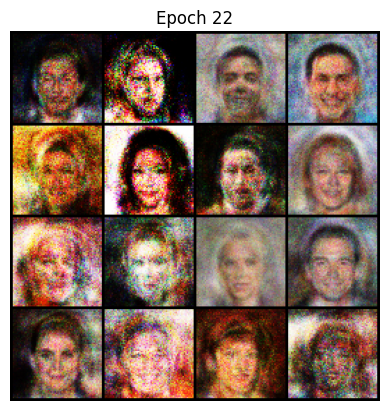

[Epoch 23/100] [Batch 0/1583] [D loss: 0.5398871302604675] [G loss: 1.1263301372528076]
[Epoch 23/100] [Batch 50/1583] [D loss: 0.5151241421699524] [G loss: 1.3403897285461426]
[Epoch 23/100] [Batch 100/1583] [D loss: 0.5253403782844543] [G loss: 1.1768827438354492]
[Epoch 23/100] [Batch 150/1583] [D loss: 0.5237655639648438] [G loss: 1.1927285194396973]
[Epoch 23/100] [Batch 200/1583] [D loss: 0.5413945913314819] [G loss: 1.2652508020401]
[Epoch 23/100] [Batch 250/1583] [D loss: 0.5656005144119263] [G loss: 1.3958418369293213]
[Epoch 23/100] [Batch 300/1583] [D loss: 0.5158874988555908] [G loss: 1.2833540439605713]
[Epoch 23/100] [Batch 350/1583] [D loss: 0.5583782196044922] [G loss: 1.1224982738494873]
[Epoch 23/100] [Batch 400/1583] [D loss: 0.5511569976806641] [G loss: 1.1993255615234375]
[Epoch 23/100] [Batch 450/1583] [D loss: 0.5702393054962158] [G loss: 1.158541202545166]
[Epoch 23/100] [Batch 500/1583] [D loss: 0.5563607811927795] [G loss: 1.0717051029205322]
[Epoch 23/100] [B

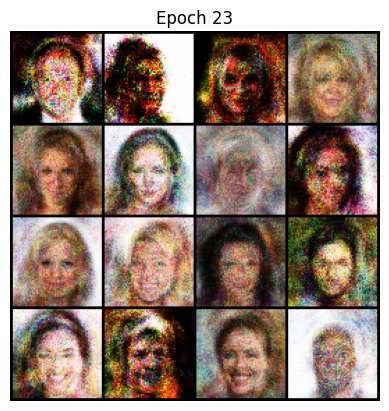

[Epoch 24/100] [Batch 0/1583] [D loss: 0.5344723463058472] [G loss: 1.078033685684204]
[Epoch 24/100] [Batch 50/1583] [D loss: 0.5384544134140015] [G loss: 1.2940129041671753]
[Epoch 24/100] [Batch 100/1583] [D loss: 0.5652527809143066] [G loss: 1.3702991008758545]
[Epoch 24/100] [Batch 150/1583] [D loss: 0.5827354192733765] [G loss: 1.1447951793670654]
[Epoch 24/100] [Batch 200/1583] [D loss: 0.5771386623382568] [G loss: 1.136353850364685]
[Epoch 24/100] [Batch 250/1583] [D loss: 0.5120633244514465] [G loss: 1.2789838314056396]
[Epoch 24/100] [Batch 300/1583] [D loss: 0.6234226226806641] [G loss: 1.2166590690612793]
[Epoch 24/100] [Batch 350/1583] [D loss: 0.5623341798782349] [G loss: 1.2396364212036133]
[Epoch 24/100] [Batch 400/1583] [D loss: 0.5332993865013123] [G loss: 1.188315749168396]
[Epoch 24/100] [Batch 450/1583] [D loss: 0.541966438293457] [G loss: 1.134099006652832]
[Epoch 24/100] [Batch 500/1583] [D loss: 0.5925600528717041] [G loss: 1.2654579877853394]
[Epoch 24/100] [Ba

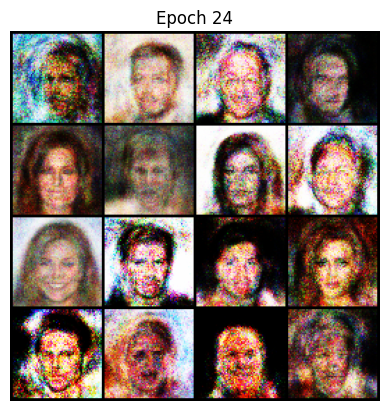

[Epoch 25/100] [Batch 0/1583] [D loss: 0.5723223686218262] [G loss: 1.142045259475708]
[Epoch 25/100] [Batch 50/1583] [D loss: 0.5532117486000061] [G loss: 1.3939073085784912]
[Epoch 25/100] [Batch 100/1583] [D loss: 0.4881090819835663] [G loss: 1.2667765617370605]
[Epoch 25/100] [Batch 150/1583] [D loss: 0.6161991953849792] [G loss: 1.476508617401123]
[Epoch 25/100] [Batch 200/1583] [D loss: 0.5029274225234985] [G loss: 1.1592780351638794]
[Epoch 25/100] [Batch 250/1583] [D loss: 0.5547384023666382] [G loss: 1.0444600582122803]
[Epoch 25/100] [Batch 300/1583] [D loss: 0.5923346281051636] [G loss: 1.336480736732483]
[Epoch 25/100] [Batch 350/1583] [D loss: 0.586216151714325] [G loss: 1.3813295364379883]
[Epoch 25/100] [Batch 400/1583] [D loss: 0.5798556804656982] [G loss: 1.333644151687622]
[Epoch 25/100] [Batch 450/1583] [D loss: 0.5282698273658752] [G loss: 1.2534323930740356]
[Epoch 25/100] [Batch 500/1583] [D loss: 0.5230580568313599] [G loss: 1.2568175792694092]
[Epoch 25/100] [Ba

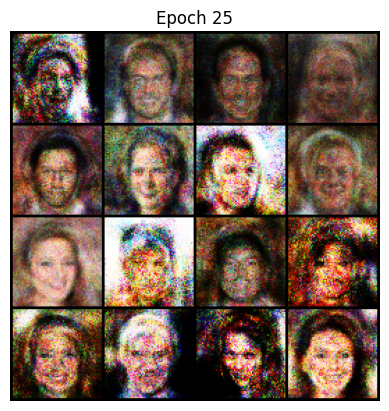

[Epoch 26/100] [Batch 0/1583] [D loss: 0.5794836282730103] [G loss: 1.1729986667633057]
[Epoch 26/100] [Batch 50/1583] [D loss: 0.5439755916595459] [G loss: 1.2347331047058105]
[Epoch 26/100] [Batch 100/1583] [D loss: 0.5194526314735413] [G loss: 1.107834815979004]
[Epoch 26/100] [Batch 150/1583] [D loss: 0.5008634328842163] [G loss: 1.2399569749832153]
[Epoch 26/100] [Batch 200/1583] [D loss: 0.5661329627037048] [G loss: 1.1847246885299683]
[Epoch 26/100] [Batch 250/1583] [D loss: 0.5623706579208374] [G loss: 1.1277728080749512]
[Epoch 26/100] [Batch 300/1583] [D loss: 0.4804007411003113] [G loss: 1.3571505546569824]
[Epoch 26/100] [Batch 350/1583] [D loss: 0.568809986114502] [G loss: 1.1981794834136963]
[Epoch 26/100] [Batch 400/1583] [D loss: 0.620086133480072] [G loss: 1.1826398372650146]
[Epoch 26/100] [Batch 450/1583] [D loss: 0.5219926834106445] [G loss: 1.36626398563385]
[Epoch 26/100] [Batch 500/1583] [D loss: 0.5057049989700317] [G loss: 1.4736297130584717]
[Epoch 26/100] [Ba

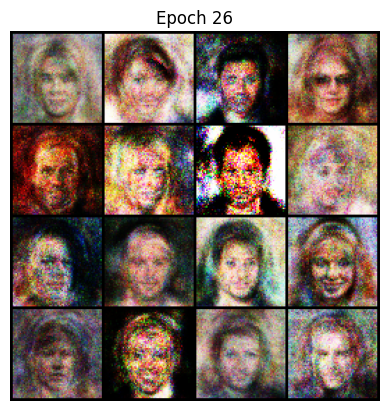

[Epoch 27/100] [Batch 0/1583] [D loss: 0.5974527597427368] [G loss: 1.4330483675003052]
[Epoch 27/100] [Batch 50/1583] [D loss: 0.5137377977371216] [G loss: 1.231726050376892]
[Epoch 27/100] [Batch 100/1583] [D loss: 0.5649504661560059] [G loss: 1.3104877471923828]
[Epoch 27/100] [Batch 150/1583] [D loss: 0.566394031047821] [G loss: 1.3022563457489014]
[Epoch 27/100] [Batch 200/1583] [D loss: 0.5588086843490601] [G loss: 1.6028170585632324]
[Epoch 27/100] [Batch 250/1583] [D loss: 0.5329376459121704] [G loss: 1.0272831916809082]
[Epoch 27/100] [Batch 300/1583] [D loss: 0.5596813559532166] [G loss: 1.1168850660324097]
[Epoch 27/100] [Batch 350/1583] [D loss: 0.523811399936676] [G loss: 1.181670069694519]
[Epoch 27/100] [Batch 400/1583] [D loss: 0.49490827322006226] [G loss: 1.3352386951446533]
[Epoch 27/100] [Batch 450/1583] [D loss: 0.5807441473007202] [G loss: 1.3844959735870361]
[Epoch 27/100] [Batch 500/1583] [D loss: 0.5231271982192993] [G loss: 1.2044239044189453]
[Epoch 27/100] [

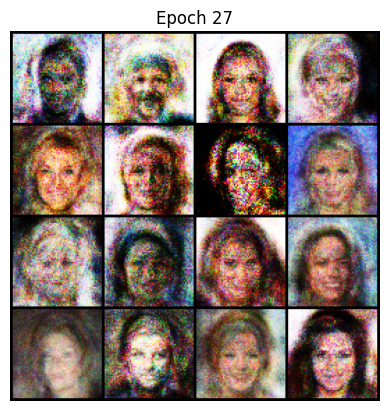

[Epoch 28/100] [Batch 0/1583] [D loss: 0.5315170884132385] [G loss: 1.206204891204834]
[Epoch 28/100] [Batch 50/1583] [D loss: 0.5066328048706055] [G loss: 1.370304822921753]
[Epoch 28/100] [Batch 100/1583] [D loss: 0.5921409726142883] [G loss: 1.1163129806518555]
[Epoch 28/100] [Batch 150/1583] [D loss: 0.5728854537010193] [G loss: 1.0892293453216553]
[Epoch 28/100] [Batch 200/1583] [D loss: 0.5269960761070251] [G loss: 1.344761848449707]
[Epoch 28/100] [Batch 250/1583] [D loss: 0.5184035301208496] [G loss: 1.1332794427871704]
[Epoch 28/100] [Batch 300/1583] [D loss: 0.5455024242401123] [G loss: 1.1029977798461914]
[Epoch 28/100] [Batch 350/1583] [D loss: 0.5110225677490234] [G loss: 1.1558029651641846]
[Epoch 28/100] [Batch 400/1583] [D loss: 0.5767518281936646] [G loss: 1.2489908933639526]
[Epoch 28/100] [Batch 450/1583] [D loss: 0.5377444624900818] [G loss: 1.1232465505599976]
[Epoch 28/100] [Batch 500/1583] [D loss: 0.4986690282821655] [G loss: 1.1107426881790161]
[Epoch 28/100] [

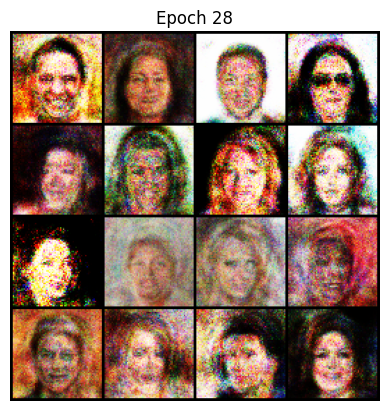

[Epoch 29/100] [Batch 0/1583] [D loss: 0.47269758582115173] [G loss: 1.3643100261688232]
[Epoch 29/100] [Batch 50/1583] [D loss: 0.4969257712364197] [G loss: 1.4329650402069092]
[Epoch 29/100] [Batch 100/1583] [D loss: 0.5896396636962891] [G loss: 1.2703778743743896]
[Epoch 29/100] [Batch 150/1583] [D loss: 0.5806858539581299] [G loss: 1.2085075378417969]
[Epoch 29/100] [Batch 200/1583] [D loss: 0.5039810538291931] [G loss: 1.1855964660644531]
[Epoch 29/100] [Batch 250/1583] [D loss: 0.5241514444351196] [G loss: 1.2398827075958252]
[Epoch 29/100] [Batch 300/1583] [D loss: 0.5626192092895508] [G loss: 1.2078642845153809]
[Epoch 29/100] [Batch 350/1583] [D loss: 0.5239943265914917] [G loss: 1.209437370300293]
[Epoch 29/100] [Batch 400/1583] [D loss: 0.5015997886657715] [G loss: 1.2072352170944214]
[Epoch 29/100] [Batch 450/1583] [D loss: 0.5167540311813354] [G loss: 1.1411641836166382]
[Epoch 29/100] [Batch 500/1583] [D loss: 0.55318284034729] [G loss: 1.3797128200531006]
[Epoch 29/100] 

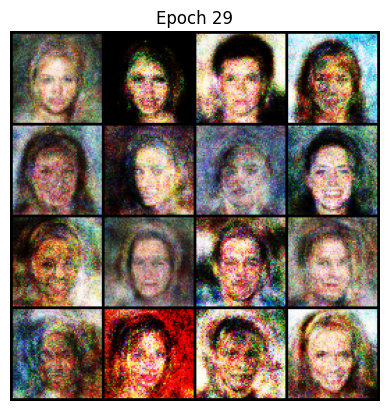

[Epoch 30/100] [Batch 0/1583] [D loss: 0.499141663312912] [G loss: 1.285942554473877]
[Epoch 30/100] [Batch 50/1583] [D loss: 0.5462175607681274] [G loss: 1.2152132987976074]
[Epoch 30/100] [Batch 100/1583] [D loss: 0.5976579189300537] [G loss: 1.34132981300354]
[Epoch 30/100] [Batch 150/1583] [D loss: 0.5875462889671326] [G loss: 1.344112753868103]
[Epoch 30/100] [Batch 200/1583] [D loss: 0.5609309673309326] [G loss: 1.3505250215530396]
[Epoch 30/100] [Batch 250/1583] [D loss: 0.5699373483657837] [G loss: 1.224326252937317]
[Epoch 30/100] [Batch 300/1583] [D loss: 0.5148401260375977] [G loss: 1.3117766380310059]
[Epoch 30/100] [Batch 350/1583] [D loss: 0.5291240215301514] [G loss: 1.2071585655212402]
[Epoch 30/100] [Batch 400/1583] [D loss: 0.5806861519813538] [G loss: 1.1993391513824463]
[Epoch 30/100] [Batch 450/1583] [D loss: 0.5569870471954346] [G loss: 1.1327791213989258]
[Epoch 30/100] [Batch 500/1583] [D loss: 0.5445716381072998] [G loss: 1.5023308992385864]
[Epoch 30/100] [Bat

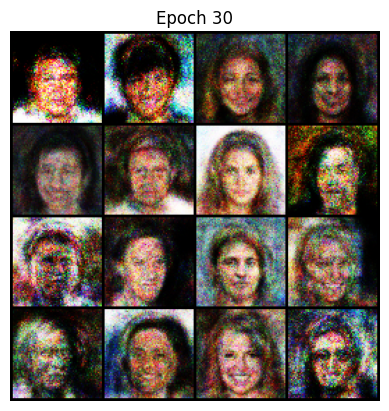

[Epoch 31/100] [Batch 0/1583] [D loss: 0.5270600318908691] [G loss: 1.3153643608093262]
[Epoch 31/100] [Batch 50/1583] [D loss: 0.5789223313331604] [G loss: 1.4561493396759033]
[Epoch 31/100] [Batch 100/1583] [D loss: 0.5654074549674988] [G loss: 1.2370755672454834]
[Epoch 31/100] [Batch 150/1583] [D loss: 0.5404424667358398] [G loss: 1.231020212173462]
[Epoch 31/100] [Batch 200/1583] [D loss: 0.5434785485267639] [G loss: 1.2643812894821167]
[Epoch 31/100] [Batch 250/1583] [D loss: 0.5362017154693604] [G loss: 1.4110816717147827]
[Epoch 31/100] [Batch 300/1583] [D loss: 0.5114575028419495] [G loss: 1.2972203493118286]
[Epoch 31/100] [Batch 350/1583] [D loss: 0.5580152273178101] [G loss: 1.2379719018936157]
[Epoch 31/100] [Batch 400/1583] [D loss: 0.5312514901161194] [G loss: 1.2078747749328613]
[Epoch 31/100] [Batch 450/1583] [D loss: 0.5357924103736877] [G loss: 1.2016575336456299]
[Epoch 31/100] [Batch 500/1583] [D loss: 0.5589148998260498] [G loss: 1.1508300304412842]
[Epoch 31/100]

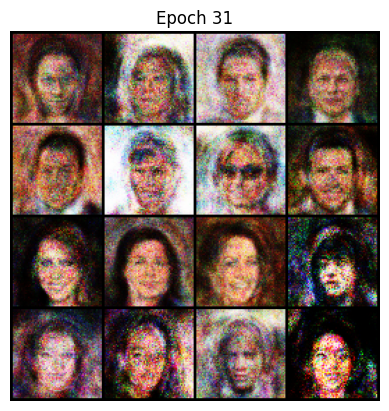

[Epoch 32/100] [Batch 0/1583] [D loss: 0.505314826965332] [G loss: 1.3316681385040283]
[Epoch 32/100] [Batch 50/1583] [D loss: 0.6018383502960205] [G loss: 1.257899284362793]
[Epoch 32/100] [Batch 100/1583] [D loss: 0.569923460483551] [G loss: 1.1435201168060303]
[Epoch 32/100] [Batch 150/1583] [D loss: 0.5461444854736328] [G loss: 1.1203601360321045]
[Epoch 32/100] [Batch 200/1583] [D loss: 0.5725547671318054] [G loss: 1.252257227897644]
[Epoch 32/100] [Batch 250/1583] [D loss: 0.5594207048416138] [G loss: 1.3109142780303955]
[Epoch 32/100] [Batch 300/1583] [D loss: 0.5442305207252502] [G loss: 1.3654334545135498]
[Epoch 32/100] [Batch 350/1583] [D loss: 0.5094997882843018] [G loss: 1.0982884168624878]
[Epoch 32/100] [Batch 400/1583] [D loss: 0.5682465434074402] [G loss: 1.3712632656097412]
[Epoch 32/100] [Batch 450/1583] [D loss: 0.49789851903915405] [G loss: 1.2452595233917236]
[Epoch 32/100] [Batch 500/1583] [D loss: 0.5305010080337524] [G loss: 1.187729835510254]
[Epoch 32/100] [B

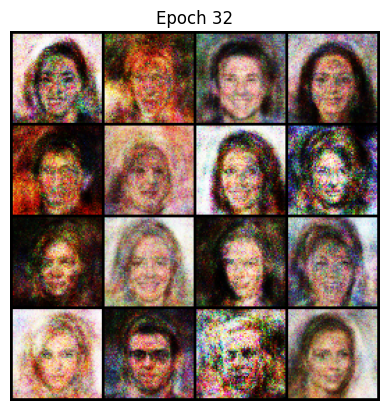

[Epoch 33/100] [Batch 0/1583] [D loss: 0.544731080532074] [G loss: 1.4249961376190186]
[Epoch 33/100] [Batch 50/1583] [D loss: 0.4953463077545166] [G loss: 1.2482939958572388]
[Epoch 33/100] [Batch 100/1583] [D loss: 0.5379449725151062] [G loss: 1.1805458068847656]
[Epoch 33/100] [Batch 150/1583] [D loss: 0.5537346601486206] [G loss: 1.0477323532104492]
[Epoch 33/100] [Batch 200/1583] [D loss: 0.553329348564148] [G loss: 1.2265214920043945]
[Epoch 33/100] [Batch 250/1583] [D loss: 0.5159510374069214] [G loss: 1.2614551782608032]
[Epoch 33/100] [Batch 300/1583] [D loss: 0.5075525045394897] [G loss: 1.2920875549316406]
[Epoch 33/100] [Batch 350/1583] [D loss: 0.5412371158599854] [G loss: 1.2803189754486084]
[Epoch 33/100] [Batch 400/1583] [D loss: 0.5713803768157959] [G loss: 1.252919316291809]
[Epoch 33/100] [Batch 450/1583] [D loss: 0.5711252093315125] [G loss: 1.2034294605255127]
[Epoch 33/100] [Batch 500/1583] [D loss: 0.5322794914245605] [G loss: 1.3060307502746582]
[Epoch 33/100] [

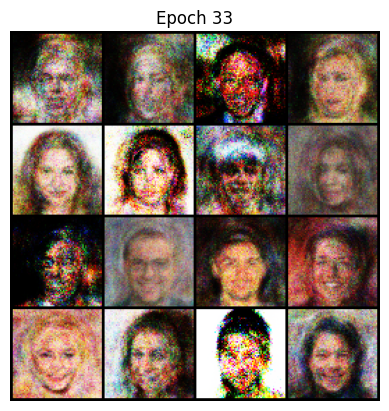

[Epoch 34/100] [Batch 0/1583] [D loss: 0.503698468208313] [G loss: 1.2303581237792969]
[Epoch 34/100] [Batch 50/1583] [D loss: 0.5023670196533203] [G loss: 1.016491413116455]
[Epoch 34/100] [Batch 100/1583] [D loss: 0.52911376953125] [G loss: 1.320884346961975]
[Epoch 34/100] [Batch 150/1583] [D loss: 0.554141640663147] [G loss: 1.2895711660385132]
[Epoch 34/100] [Batch 200/1583] [D loss: 0.538857102394104] [G loss: 1.3322954177856445]
[Epoch 34/100] [Batch 250/1583] [D loss: 0.48367780447006226] [G loss: 1.2896978855133057]
[Epoch 34/100] [Batch 300/1583] [D loss: 0.5931166410446167] [G loss: 1.1849390268325806]
[Epoch 34/100] [Batch 350/1583] [D loss: 0.5662287473678589] [G loss: 1.410062551498413]
[Epoch 34/100] [Batch 400/1583] [D loss: 0.5295882821083069] [G loss: 1.3260332345962524]
[Epoch 34/100] [Batch 450/1583] [D loss: 0.5294004082679749] [G loss: 1.4407904148101807]
[Epoch 34/100] [Batch 500/1583] [D loss: 0.47928136587142944] [G loss: 1.2131586074829102]
[Epoch 34/100] [Bat

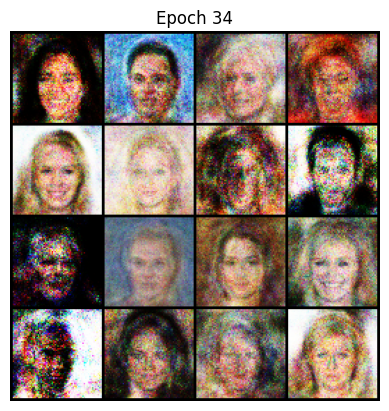

[Epoch 35/100] [Batch 0/1583] [D loss: 0.4991120994091034] [G loss: 1.2541029453277588]
[Epoch 35/100] [Batch 50/1583] [D loss: 0.589042067527771] [G loss: 1.260411024093628]
[Epoch 35/100] [Batch 100/1583] [D loss: 0.5509900450706482] [G loss: 1.2101887464523315]
[Epoch 35/100] [Batch 150/1583] [D loss: 0.5526759624481201] [G loss: 1.369168758392334]
[Epoch 35/100] [Batch 200/1583] [D loss: 0.5551090240478516] [G loss: 1.2069518566131592]
[Epoch 35/100] [Batch 250/1583] [D loss: 0.5353784561157227] [G loss: 1.4095289707183838]
[Epoch 35/100] [Batch 300/1583] [D loss: 0.5035251379013062] [G loss: 1.3233722448349]
[Epoch 35/100] [Batch 350/1583] [D loss: 0.6040955781936646] [G loss: 1.3159704208374023]
[Epoch 35/100] [Batch 400/1583] [D loss: 0.5620287656784058] [G loss: 1.2352583408355713]
[Epoch 35/100] [Batch 450/1583] [D loss: 0.5724754333496094] [G loss: 0.9809094667434692]
[Epoch 35/100] [Batch 500/1583] [D loss: 0.5137976408004761] [G loss: 1.211246132850647]
[Epoch 35/100] [Batc

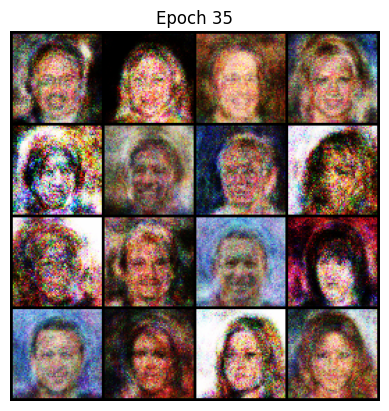

[Epoch 36/100] [Batch 0/1583] [D loss: 0.4811120629310608] [G loss: 1.4196298122406006]
[Epoch 36/100] [Batch 50/1583] [D loss: 0.5206986665725708] [G loss: 1.192931890487671]
[Epoch 36/100] [Batch 100/1583] [D loss: 0.4602022171020508] [G loss: 1.2811789512634277]
[Epoch 36/100] [Batch 150/1583] [D loss: 0.5751686096191406] [G loss: 1.347464680671692]
[Epoch 36/100] [Batch 200/1583] [D loss: 0.5943145155906677] [G loss: 1.3975926637649536]
[Epoch 36/100] [Batch 250/1583] [D loss: 0.6259481906890869] [G loss: 1.0692880153656006]
[Epoch 36/100] [Batch 300/1583] [D loss: 0.5281772613525391] [G loss: 1.3262933492660522]
[Epoch 36/100] [Batch 350/1583] [D loss: 0.5602368116378784] [G loss: 1.4401806592941284]
[Epoch 36/100] [Batch 400/1583] [D loss: 0.5574345588684082] [G loss: 1.2686185836791992]
[Epoch 36/100] [Batch 450/1583] [D loss: 0.559389591217041] [G loss: 1.1985085010528564]
[Epoch 36/100] [Batch 500/1583] [D loss: 0.5554133653640747] [G loss: 1.3111745119094849]
[Epoch 36/100] [

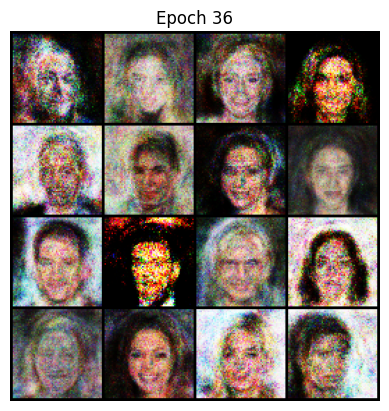

[Epoch 37/100] [Batch 0/1583] [D loss: 0.5397865772247314] [G loss: 1.6420412063598633]
[Epoch 37/100] [Batch 50/1583] [D loss: 0.6063967943191528] [G loss: 1.3567044734954834]
[Epoch 37/100] [Batch 100/1583] [D loss: 0.5596650838851929] [G loss: 1.3288518190383911]
[Epoch 37/100] [Batch 150/1583] [D loss: 0.49930059909820557] [G loss: 1.2475121021270752]
[Epoch 37/100] [Batch 200/1583] [D loss: 0.5376166701316833] [G loss: 1.4451632499694824]
[Epoch 37/100] [Batch 250/1583] [D loss: 0.5162762403488159] [G loss: 1.1980080604553223]
[Epoch 37/100] [Batch 300/1583] [D loss: 0.5508674383163452] [G loss: 0.9359143972396851]
[Epoch 37/100] [Batch 350/1583] [D loss: 0.521874189376831] [G loss: 1.4217395782470703]
[Epoch 37/100] [Batch 400/1583] [D loss: 0.5741692781448364] [G loss: 1.2492016553878784]
[Epoch 37/100] [Batch 450/1583] [D loss: 0.5039503574371338] [G loss: 1.2697850465774536]
[Epoch 37/100] [Batch 500/1583] [D loss: 0.4710109233856201] [G loss: 1.2395626306533813]
[Epoch 37/100

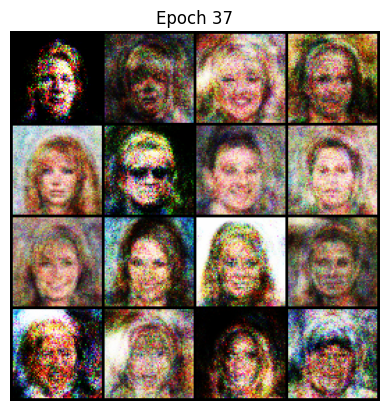

[Epoch 38/100] [Batch 0/1583] [D loss: 0.5521489977836609] [G loss: 1.3759459257125854]
[Epoch 38/100] [Batch 50/1583] [D loss: 0.4703807234764099] [G loss: 1.5362956523895264]
[Epoch 38/100] [Batch 100/1583] [D loss: 0.5714452266693115] [G loss: 1.2082254886627197]
[Epoch 38/100] [Batch 150/1583] [D loss: 0.48541292548179626] [G loss: 1.30423903465271]
[Epoch 38/100] [Batch 200/1583] [D loss: 0.48377859592437744] [G loss: 1.1818194389343262]
[Epoch 38/100] [Batch 250/1583] [D loss: 0.5434269905090332] [G loss: 1.3127391338348389]
[Epoch 38/100] [Batch 300/1583] [D loss: 0.5319429636001587] [G loss: 1.2639150619506836]
[Epoch 38/100] [Batch 350/1583] [D loss: 0.507145881652832] [G loss: 1.2365326881408691]
[Epoch 38/100] [Batch 400/1583] [D loss: 0.5233073234558105] [G loss: 1.1383352279663086]
[Epoch 38/100] [Batch 450/1583] [D loss: 0.574185848236084] [G loss: 1.1068854331970215]
[Epoch 38/100] [Batch 500/1583] [D loss: 0.4712699055671692] [G loss: 1.401954174041748]
[Epoch 38/100] [

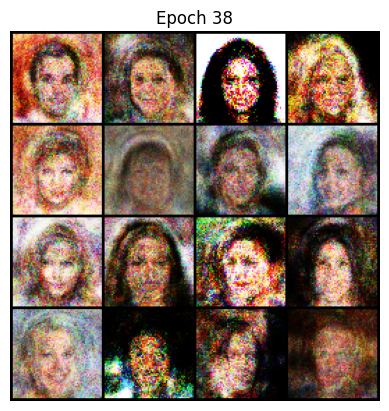

[Epoch 39/100] [Batch 0/1583] [D loss: 0.535086989402771] [G loss: 1.3644403219223022]
[Epoch 39/100] [Batch 50/1583] [D loss: 0.4978189766407013] [G loss: 1.2267416715621948]
[Epoch 39/100] [Batch 100/1583] [D loss: 0.5033667087554932] [G loss: 1.3246991634368896]
[Epoch 39/100] [Batch 150/1583] [D loss: 0.5264726281166077] [G loss: 1.409180998802185]
[Epoch 39/100] [Batch 200/1583] [D loss: 0.5147499442100525] [G loss: 1.4563148021697998]
[Epoch 39/100] [Batch 250/1583] [D loss: 0.5017660856246948] [G loss: 1.2510842084884644]
[Epoch 39/100] [Batch 300/1583] [D loss: 0.4934079945087433] [G loss: 1.4331731796264648]
[Epoch 39/100] [Batch 350/1583] [D loss: 0.5300354957580566] [G loss: 1.2355387210845947]
[Epoch 39/100] [Batch 400/1583] [D loss: 0.5261600017547607] [G loss: 1.2567553520202637]
[Epoch 39/100] [Batch 450/1583] [D loss: 0.4827096462249756] [G loss: 1.3662071228027344]
[Epoch 39/100] [Batch 500/1583] [D loss: 0.5401259660720825] [G loss: 1.0959488153457642]
[Epoch 39/100] 

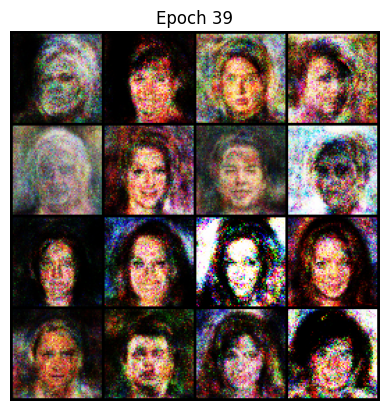

[Epoch 40/100] [Batch 0/1583] [D loss: 0.5710381269454956] [G loss: 1.2657606601715088]
[Epoch 40/100] [Batch 50/1583] [D loss: 0.5635532140731812] [G loss: 1.2793526649475098]
[Epoch 40/100] [Batch 100/1583] [D loss: 0.4895273447036743] [G loss: 1.4174983501434326]
[Epoch 40/100] [Batch 150/1583] [D loss: 0.5089884996414185] [G loss: 1.348189353942871]
[Epoch 40/100] [Batch 200/1583] [D loss: 0.4396430253982544] [G loss: 1.239816427230835]
[Epoch 40/100] [Batch 250/1583] [D loss: 0.4836663603782654] [G loss: 1.4462556838989258]
[Epoch 40/100] [Batch 300/1583] [D loss: 0.5519894361495972] [G loss: 1.3346880674362183]
[Epoch 40/100] [Batch 350/1583] [D loss: 0.5636254549026489] [G loss: 1.2219310998916626]
[Epoch 40/100] [Batch 400/1583] [D loss: 0.4983075261116028] [G loss: 1.2836973667144775]
[Epoch 40/100] [Batch 450/1583] [D loss: 0.5446476936340332] [G loss: 1.4109711647033691]
[Epoch 40/100] [Batch 500/1583] [D loss: 0.5963842868804932] [G loss: 1.3360495567321777]
[Epoch 40/100] 

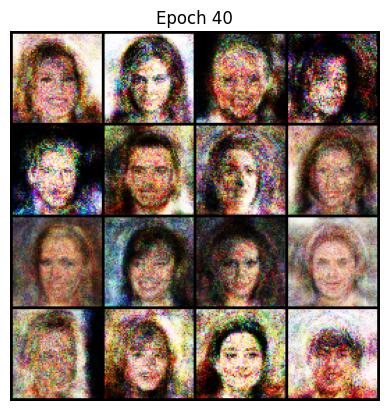

[Epoch 41/100] [Batch 0/1583] [D loss: 0.5162773132324219] [G loss: 1.3305354118347168]
[Epoch 41/100] [Batch 50/1583] [D loss: 0.4970015287399292] [G loss: 1.2308138608932495]
[Epoch 41/100] [Batch 100/1583] [D loss: 0.5318363904953003] [G loss: 1.2736687660217285]
[Epoch 41/100] [Batch 150/1583] [D loss: 0.5185786485671997] [G loss: 1.5251634120941162]
[Epoch 41/100] [Batch 200/1583] [D loss: 0.5571630001068115] [G loss: 1.1733086109161377]
[Epoch 41/100] [Batch 250/1583] [D loss: 0.4821218252182007] [G loss: 1.3964968919754028]
[Epoch 41/100] [Batch 300/1583] [D loss: 0.5048376321792603] [G loss: 1.5160512924194336]
[Epoch 41/100] [Batch 350/1583] [D loss: 0.5927522778511047] [G loss: 1.115652084350586]
[Epoch 41/100] [Batch 400/1583] [D loss: 0.46876201033592224] [G loss: 1.4427205324172974]
[Epoch 41/100] [Batch 450/1583] [D loss: 0.5266234874725342] [G loss: 1.6987030506134033]
[Epoch 41/100] [Batch 500/1583] [D loss: 0.5258121490478516] [G loss: 1.236358880996704]
[Epoch 41/100]

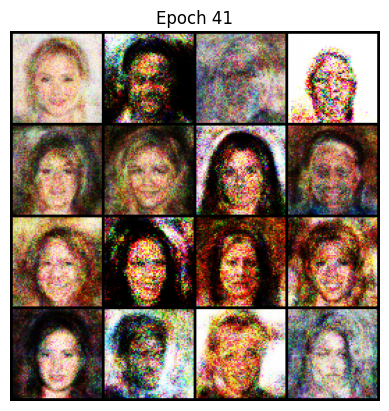

[Epoch 42/100] [Batch 0/1583] [D loss: 0.5283107757568359] [G loss: 1.1280275583267212]
[Epoch 42/100] [Batch 50/1583] [D loss: 0.46628475189208984] [G loss: 1.1284239292144775]
[Epoch 42/100] [Batch 100/1583] [D loss: 0.5512408018112183] [G loss: 1.534409761428833]
[Epoch 42/100] [Batch 150/1583] [D loss: 0.5304428935050964] [G loss: 1.398199200630188]
[Epoch 42/100] [Batch 200/1583] [D loss: 0.5071665644645691] [G loss: 1.2973960638046265]
[Epoch 42/100] [Batch 250/1583] [D loss: 0.5315120816230774] [G loss: 1.313018798828125]
[Epoch 42/100] [Batch 300/1583] [D loss: 0.5068591833114624] [G loss: 1.3556801080703735]
[Epoch 42/100] [Batch 350/1583] [D loss: 0.5489178895950317] [G loss: 1.5125375986099243]
[Epoch 42/100] [Batch 400/1583] [D loss: 0.5191566944122314] [G loss: 1.2931768894195557]
[Epoch 42/100] [Batch 450/1583] [D loss: 0.5262474417686462] [G loss: 1.273146629333496]
[Epoch 42/100] [Batch 500/1583] [D loss: 0.5499973297119141] [G loss: 1.1690083742141724]
[Epoch 42/100] [

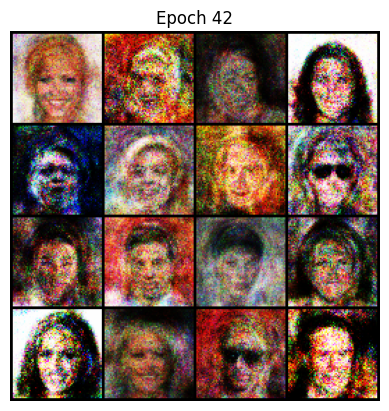

[Epoch 43/100] [Batch 0/1583] [D loss: 0.5528944730758667] [G loss: 1.4586601257324219]
[Epoch 43/100] [Batch 50/1583] [D loss: 0.5178894996643066] [G loss: 1.2981345653533936]
[Epoch 43/100] [Batch 100/1583] [D loss: 0.5786733627319336] [G loss: 1.6238770484924316]
[Epoch 43/100] [Batch 150/1583] [D loss: 0.47496914863586426] [G loss: 1.5054388046264648]
[Epoch 43/100] [Batch 200/1583] [D loss: 0.48247459530830383] [G loss: 1.3627018928527832]
[Epoch 43/100] [Batch 250/1583] [D loss: 0.525627076625824] [G loss: 1.4138987064361572]
[Epoch 43/100] [Batch 300/1583] [D loss: 0.6038317680358887] [G loss: 1.2829264402389526]
[Epoch 43/100] [Batch 350/1583] [D loss: 0.5904568433761597] [G loss: 1.26621413230896]
[Epoch 43/100] [Batch 400/1583] [D loss: 0.5444226861000061] [G loss: 1.37956964969635]
[Epoch 43/100] [Batch 450/1583] [D loss: 0.4994640648365021] [G loss: 1.4119718074798584]
[Epoch 43/100] [Batch 500/1583] [D loss: 0.5260492563247681] [G loss: 1.4775152206420898]
[Epoch 43/100] [

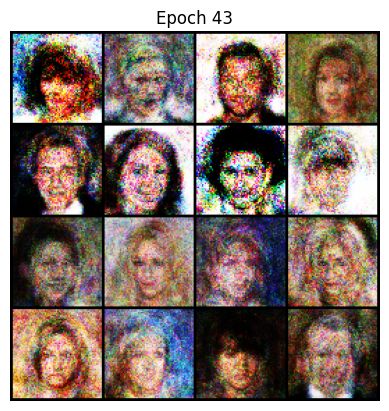

[Epoch 44/100] [Batch 0/1583] [D loss: 0.5105973482131958] [G loss: 1.3623411655426025]
[Epoch 44/100] [Batch 50/1583] [D loss: 0.5522751808166504] [G loss: 1.3069021701812744]
[Epoch 44/100] [Batch 100/1583] [D loss: 0.5366063117980957] [G loss: 1.0953179597854614]
[Epoch 44/100] [Batch 150/1583] [D loss: 0.48291024565696716] [G loss: 1.2694178819656372]
[Epoch 44/100] [Batch 200/1583] [D loss: 0.5446060299873352] [G loss: 1.3302149772644043]
[Epoch 44/100] [Batch 250/1583] [D loss: 0.5590130090713501] [G loss: 1.3192616701126099]
[Epoch 44/100] [Batch 300/1583] [D loss: 0.515781044960022] [G loss: 1.0989853143692017]
[Epoch 44/100] [Batch 350/1583] [D loss: 0.5389185547828674] [G loss: 1.287757396697998]
[Epoch 44/100] [Batch 400/1583] [D loss: 0.5897436141967773] [G loss: 1.3659881353378296]
[Epoch 44/100] [Batch 450/1583] [D loss: 0.5179435014724731] [G loss: 1.3448753356933594]
[Epoch 44/100] [Batch 500/1583] [D loss: 0.5545147657394409] [G loss: 1.1839920282363892]
[Epoch 44/100]

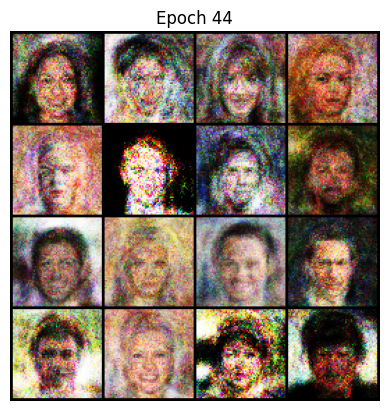

[Epoch 45/100] [Batch 0/1583] [D loss: 0.5262496471405029] [G loss: 1.3106727600097656]
[Epoch 45/100] [Batch 50/1583] [D loss: 0.4883136749267578] [G loss: 1.128196358680725]
[Epoch 45/100] [Batch 100/1583] [D loss: 0.48024246096611023] [G loss: 1.415266752243042]
[Epoch 45/100] [Batch 150/1583] [D loss: 0.5431024432182312] [G loss: 1.3194646835327148]
[Epoch 45/100] [Batch 200/1583] [D loss: 0.49246302247047424] [G loss: 1.224496841430664]
[Epoch 45/100] [Batch 250/1583] [D loss: 0.5055910348892212] [G loss: 1.2542296648025513]
[Epoch 45/100] [Batch 300/1583] [D loss: 0.4720763564109802] [G loss: 1.3446236848831177]
[Epoch 45/100] [Batch 350/1583] [D loss: 0.5647679567337036] [G loss: 1.2454860210418701]
[Epoch 45/100] [Batch 400/1583] [D loss: 0.5373631715774536] [G loss: 1.1737985610961914]
[Epoch 45/100] [Batch 450/1583] [D loss: 0.5668916702270508] [G loss: 1.3600001335144043]
[Epoch 45/100] [Batch 500/1583] [D loss: 0.47263479232788086] [G loss: 1.3066258430480957]
[Epoch 45/100

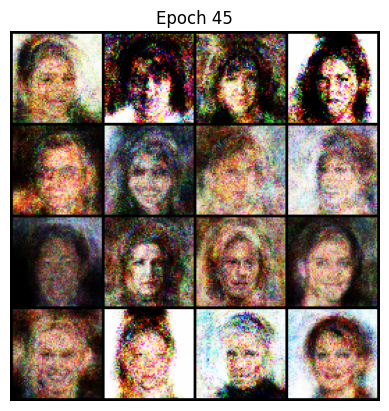

[Epoch 46/100] [Batch 0/1583] [D loss: 0.5225488543510437] [G loss: 1.3169500827789307]
[Epoch 46/100] [Batch 50/1583] [D loss: 0.4687555730342865] [G loss: 1.417506217956543]
[Epoch 46/100] [Batch 100/1583] [D loss: 0.5018874406814575] [G loss: 1.3666918277740479]
[Epoch 46/100] [Batch 150/1583] [D loss: 0.5488722324371338] [G loss: 1.374814748764038]
[Epoch 46/100] [Batch 200/1583] [D loss: 0.5535829067230225] [G loss: 1.4028980731964111]
[Epoch 46/100] [Batch 250/1583] [D loss: 0.46814143657684326] [G loss: 1.2097015380859375]
[Epoch 46/100] [Batch 300/1583] [D loss: 0.552353024482727] [G loss: 1.4712525606155396]
[Epoch 46/100] [Batch 350/1583] [D loss: 0.4536125659942627] [G loss: 1.349502444267273]
[Epoch 46/100] [Batch 400/1583] [D loss: 0.5563730001449585] [G loss: 1.3497405052185059]
[Epoch 46/100] [Batch 450/1583] [D loss: 0.4748061001300812] [G loss: 1.3879852294921875]
[Epoch 46/100] [Batch 500/1583] [D loss: 0.503936767578125] [G loss: 1.635283350944519]
[Epoch 46/100] [Ba

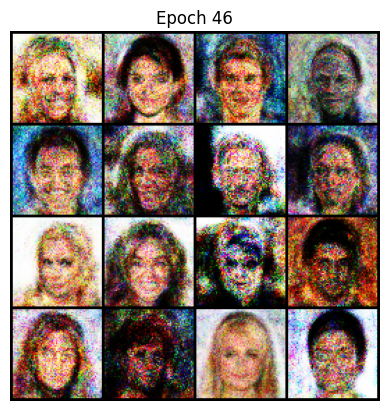

[Epoch 47/100] [Batch 0/1583] [D loss: 0.5471068620681763] [G loss: 1.5514558553695679]
[Epoch 47/100] [Batch 50/1583] [D loss: 0.49084311723709106] [G loss: 1.3386709690093994]
[Epoch 47/100] [Batch 100/1583] [D loss: 0.5654474496841431] [G loss: 1.5098519325256348]
[Epoch 47/100] [Batch 150/1583] [D loss: 0.4832499325275421] [G loss: 1.1318261623382568]
[Epoch 47/100] [Batch 200/1583] [D loss: 0.5721479058265686] [G loss: 1.4104630947113037]
[Epoch 47/100] [Batch 250/1583] [D loss: 0.5049314498901367] [G loss: 1.2558746337890625]
[Epoch 47/100] [Batch 300/1583] [D loss: 0.48278966546058655] [G loss: 1.3380770683288574]
[Epoch 47/100] [Batch 350/1583] [D loss: 0.49847620725631714] [G loss: 1.3713446855545044]
[Epoch 47/100] [Batch 400/1583] [D loss: 0.4976142346858978] [G loss: 1.3734641075134277]
[Epoch 47/100] [Batch 450/1583] [D loss: 0.49824705719947815] [G loss: 1.3310801982879639]
[Epoch 47/100] [Batch 500/1583] [D loss: 0.48169228434562683] [G loss: 1.3083581924438477]
[Epoch 4

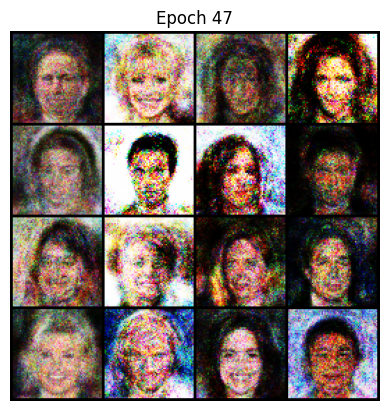

[Epoch 48/100] [Batch 0/1583] [D loss: 0.5659960508346558] [G loss: 1.2581207752227783]
[Epoch 48/100] [Batch 50/1583] [D loss: 0.5380158424377441] [G loss: 1.343066692352295]
[Epoch 48/100] [Batch 100/1583] [D loss: 0.47622865438461304] [G loss: 1.2992684841156006]
[Epoch 48/100] [Batch 150/1583] [D loss: 0.49889713525772095] [G loss: 1.3152756690979004]
[Epoch 48/100] [Batch 200/1583] [D loss: 0.5247678756713867] [G loss: 1.3606274127960205]
[Epoch 48/100] [Batch 250/1583] [D loss: 0.5242900848388672] [G loss: 1.405421257019043]
[Epoch 48/100] [Batch 300/1583] [D loss: 0.5405051708221436] [G loss: 1.2929232120513916]
[Epoch 48/100] [Batch 350/1583] [D loss: 0.5290157794952393] [G loss: 1.2127141952514648]
[Epoch 48/100] [Batch 400/1583] [D loss: 0.4969705045223236] [G loss: 1.5631582736968994]
[Epoch 48/100] [Batch 450/1583] [D loss: 0.5346713066101074] [G loss: 1.5218744277954102]
[Epoch 48/100] [Batch 500/1583] [D loss: 0.47456520795822144] [G loss: 1.3231559991836548]
[Epoch 48/10

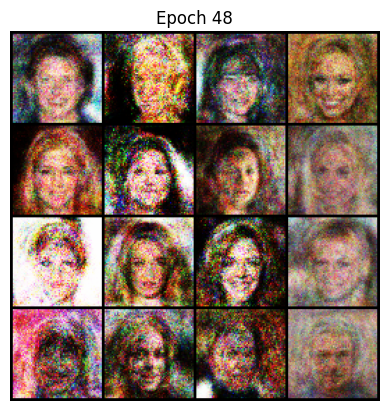

[Epoch 49/100] [Batch 0/1583] [D loss: 0.5202479362487793] [G loss: 1.3685274124145508]
[Epoch 49/100] [Batch 50/1583] [D loss: 0.4765828847885132] [G loss: 1.251235842704773]
[Epoch 49/100] [Batch 100/1583] [D loss: 0.46980974078178406] [G loss: 1.4599907398223877]
[Epoch 49/100] [Batch 150/1583] [D loss: 0.5036525726318359] [G loss: 1.6568233966827393]
[Epoch 49/100] [Batch 200/1583] [D loss: 0.5705692768096924] [G loss: 1.324747920036316]
[Epoch 49/100] [Batch 250/1583] [D loss: 0.4970218539237976] [G loss: 1.3018454313278198]
[Epoch 49/100] [Batch 300/1583] [D loss: 0.5488573312759399] [G loss: 1.1918132305145264]
[Epoch 49/100] [Batch 350/1583] [D loss: 0.502865195274353] [G loss: 1.4621362686157227]
[Epoch 49/100] [Batch 400/1583] [D loss: 0.46706002950668335] [G loss: 1.3755502700805664]
[Epoch 49/100] [Batch 450/1583] [D loss: 0.5529659986495972] [G loss: 1.501368522644043]
[Epoch 49/100] [Batch 500/1583] [D loss: 0.5008035898208618] [G loss: 1.1706676483154297]
[Epoch 49/100] 

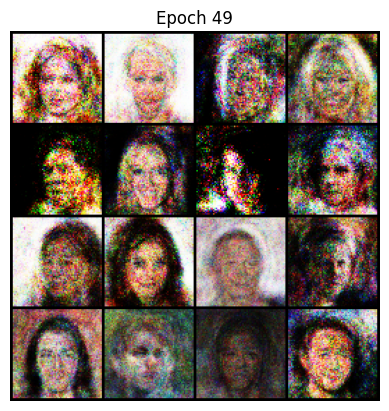

[Epoch 50/100] [Batch 0/1583] [D loss: 0.46737247705459595] [G loss: 1.2416369915008545]
[Epoch 50/100] [Batch 50/1583] [D loss: 0.4923182725906372] [G loss: 1.2937648296356201]
[Epoch 50/100] [Batch 100/1583] [D loss: 0.5077060461044312] [G loss: 1.3912444114685059]
[Epoch 50/100] [Batch 150/1583] [D loss: 0.5347058773040771] [G loss: 1.5310783386230469]
[Epoch 50/100] [Batch 200/1583] [D loss: 0.5224213600158691] [G loss: 1.4487810134887695]
[Epoch 50/100] [Batch 250/1583] [D loss: 0.5238520503044128] [G loss: 1.5336101055145264]
[Epoch 50/100] [Batch 300/1583] [D loss: 0.49495354294776917] [G loss: 1.3827600479125977]
[Epoch 50/100] [Batch 350/1583] [D loss: 0.5203319787979126] [G loss: 1.3735958337783813]
[Epoch 50/100] [Batch 400/1583] [D loss: 0.5874389410018921] [G loss: 1.3982195854187012]
[Epoch 50/100] [Batch 450/1583] [D loss: 0.5296732783317566] [G loss: 1.335430383682251]
[Epoch 50/100] [Batch 500/1583] [D loss: 0.5191158056259155] [G loss: 1.311213731765747]
[Epoch 50/100

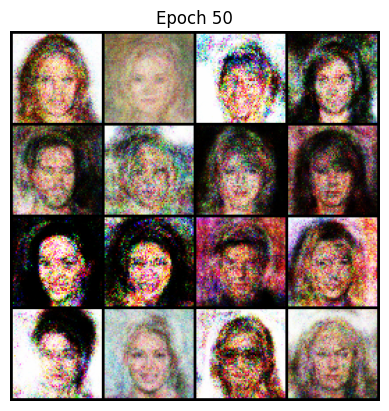

[Epoch 51/100] [Batch 0/1583] [D loss: 0.49531954526901245] [G loss: 1.4263542890548706]
[Epoch 51/100] [Batch 50/1583] [D loss: 0.5265093445777893] [G loss: 1.3483164310455322]
[Epoch 51/100] [Batch 100/1583] [D loss: 0.4838242530822754] [G loss: 1.4949992895126343]
[Epoch 51/100] [Batch 150/1583] [D loss: 0.5634752511978149] [G loss: 1.20540452003479]
[Epoch 51/100] [Batch 200/1583] [D loss: 0.48854392766952515] [G loss: 1.441406011581421]
[Epoch 51/100] [Batch 250/1583] [D loss: 0.5092096924781799] [G loss: 1.1962556838989258]
[Epoch 51/100] [Batch 300/1583] [D loss: 0.5456359386444092] [G loss: 1.2844716310501099]
[Epoch 51/100] [Batch 350/1583] [D loss: 0.5164782404899597] [G loss: 1.2696274518966675]
[Epoch 51/100] [Batch 400/1583] [D loss: 0.517704427242279] [G loss: 1.3541033267974854]
[Epoch 51/100] [Batch 450/1583] [D loss: 0.45754343271255493] [G loss: 1.2860710620880127]
[Epoch 51/100] [Batch 500/1583] [D loss: 0.4712223410606384] [G loss: 1.3757603168487549]
[Epoch 51/100]

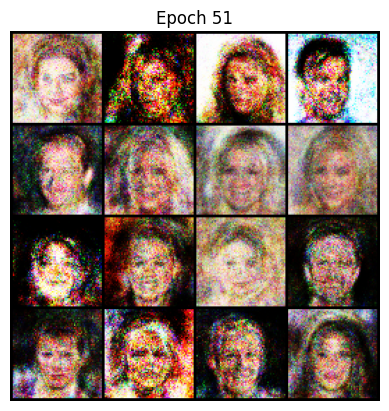

[Epoch 52/100] [Batch 0/1583] [D loss: 0.4953639805316925] [G loss: 1.360316276550293]
[Epoch 52/100] [Batch 50/1583] [D loss: 0.5388638377189636] [G loss: 1.5444726943969727]
[Epoch 52/100] [Batch 100/1583] [D loss: 0.4512278437614441] [G loss: 1.5135695934295654]
[Epoch 52/100] [Batch 150/1583] [D loss: 0.49201256036758423] [G loss: 1.1644278764724731]
[Epoch 52/100] [Batch 200/1583] [D loss: 0.4328930974006653] [G loss: 1.3540345430374146]
[Epoch 52/100] [Batch 250/1583] [D loss: 0.5583438873291016] [G loss: 1.308992862701416]
[Epoch 52/100] [Batch 300/1583] [D loss: 0.5258738398551941] [G loss: 1.1886078119277954]
[Epoch 52/100] [Batch 350/1583] [D loss: 0.4676591753959656] [G loss: 1.419124722480774]
[Epoch 52/100] [Batch 400/1583] [D loss: 0.5140182971954346] [G loss: 1.173136591911316]
[Epoch 52/100] [Batch 450/1583] [D loss: 0.610498309135437] [G loss: 1.2452043294906616]
[Epoch 52/100] [Batch 500/1583] [D loss: 0.4946766197681427] [G loss: 1.4087677001953125]
[Epoch 52/100] [B

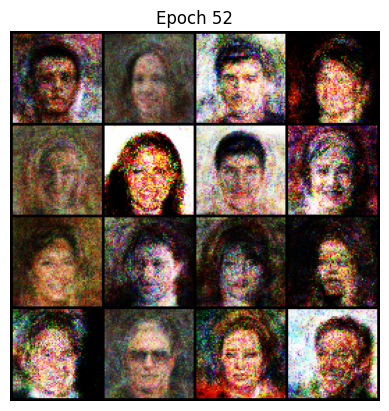

[Epoch 53/100] [Batch 0/1583] [D loss: 0.46836185455322266] [G loss: 1.4281269311904907]
[Epoch 53/100] [Batch 50/1583] [D loss: 0.5085890889167786] [G loss: 1.3970541954040527]
[Epoch 53/100] [Batch 100/1583] [D loss: 0.5233539342880249] [G loss: 1.2768683433532715]
[Epoch 53/100] [Batch 150/1583] [D loss: 0.4675857722759247] [G loss: 1.3546909093856812]
[Epoch 53/100] [Batch 200/1583] [D loss: 0.49842047691345215] [G loss: 1.4458909034729004]
[Epoch 53/100] [Batch 250/1583] [D loss: 0.4575577676296234] [G loss: 1.515228033065796]
[Epoch 53/100] [Batch 300/1583] [D loss: 0.565127432346344] [G loss: 1.4287660121917725]
[Epoch 53/100] [Batch 350/1583] [D loss: 0.4534749686717987] [G loss: 1.4004594087600708]
[Epoch 53/100] [Batch 400/1583] [D loss: 0.5300542712211609] [G loss: 1.2962555885314941]
[Epoch 53/100] [Batch 450/1583] [D loss: 0.5040748715400696] [G loss: 1.2668659687042236]
[Epoch 53/100] [Batch 500/1583] [D loss: 0.5530118346214294] [G loss: 1.4430209398269653]
[Epoch 53/100

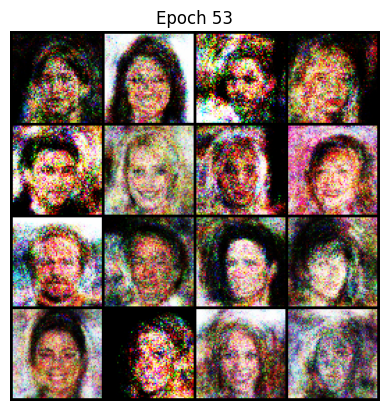

[Epoch 54/100] [Batch 0/1583] [D loss: 0.5271102786064148] [G loss: 1.43448805809021]
[Epoch 54/100] [Batch 50/1583] [D loss: 0.5423043966293335] [G loss: 1.1590334177017212]
[Epoch 54/100] [Batch 100/1583] [D loss: 0.5107662677764893] [G loss: 1.351306676864624]
[Epoch 54/100] [Batch 150/1583] [D loss: 0.5432959794998169] [G loss: 1.124377727508545]
[Epoch 54/100] [Batch 200/1583] [D loss: 0.5561460256576538] [G loss: 1.5206353664398193]
[Epoch 54/100] [Batch 250/1583] [D loss: 0.5179434418678284] [G loss: 1.4971363544464111]
[Epoch 54/100] [Batch 300/1583] [D loss: 0.4529581069946289] [G loss: 1.2542853355407715]
[Epoch 54/100] [Batch 350/1583] [D loss: 0.5551298260688782] [G loss: 1.4539999961853027]
[Epoch 54/100] [Batch 400/1583] [D loss: 0.48385676741600037] [G loss: 1.5507718324661255]
[Epoch 54/100] [Batch 450/1583] [D loss: 0.5233882665634155] [G loss: 1.4727345705032349]
[Epoch 54/100] [Batch 500/1583] [D loss: 0.5444818139076233] [G loss: 1.4864678382873535]
[Epoch 54/100] [

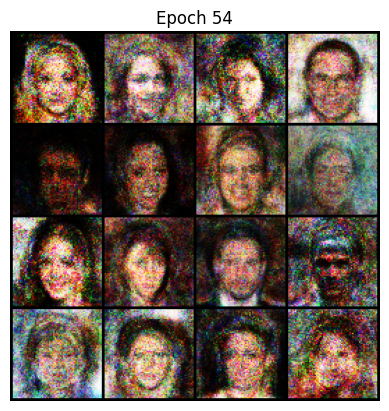

[Epoch 55/100] [Batch 0/1583] [D loss: 0.4739806652069092] [G loss: 1.368971347808838]
[Epoch 55/100] [Batch 50/1583] [D loss: 0.572236955165863] [G loss: 1.7121851444244385]
[Epoch 55/100] [Batch 100/1583] [D loss: 0.47800329327583313] [G loss: 1.200282335281372]
[Epoch 55/100] [Batch 150/1583] [D loss: 0.5105469226837158] [G loss: 1.2847223281860352]
[Epoch 55/100] [Batch 200/1583] [D loss: 0.5408634543418884] [G loss: 1.5193939208984375]
[Epoch 55/100] [Batch 250/1583] [D loss: 0.4901626706123352] [G loss: 1.3372926712036133]
[Epoch 55/100] [Batch 300/1583] [D loss: 0.5425878167152405] [G loss: 1.3427345752716064]
[Epoch 55/100] [Batch 350/1583] [D loss: 0.5481800436973572] [G loss: 1.3847171068191528]
[Epoch 55/100] [Batch 400/1583] [D loss: 0.4502951502799988] [G loss: 1.4528319835662842]
[Epoch 55/100] [Batch 450/1583] [D loss: 0.5209379196166992] [G loss: 1.4693790674209595]
[Epoch 55/100] [Batch 500/1583] [D loss: 0.545762836933136] [G loss: 1.2499730587005615]
[Epoch 55/100] [

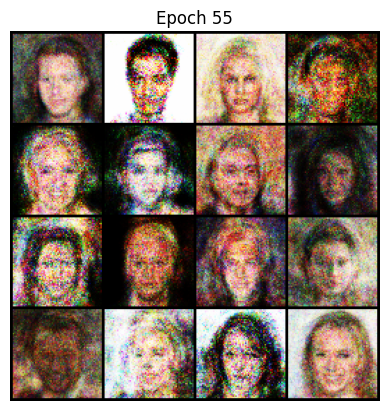

[Epoch 56/100] [Batch 0/1583] [D loss: 0.5178403854370117] [G loss: 1.2388451099395752]
[Epoch 56/100] [Batch 50/1583] [D loss: 0.5336424708366394] [G loss: 1.317936658859253]
[Epoch 56/100] [Batch 100/1583] [D loss: 0.4785938858985901] [G loss: 1.4460865259170532]
[Epoch 56/100] [Batch 150/1583] [D loss: 0.49295273423194885] [G loss: 1.479628562927246]
[Epoch 56/100] [Batch 200/1583] [D loss: 0.5268117189407349] [G loss: 1.5285370349884033]
[Epoch 56/100] [Batch 250/1583] [D loss: 0.44638487696647644] [G loss: 1.3491899967193604]
[Epoch 56/100] [Batch 300/1583] [D loss: 0.4877097010612488] [G loss: 1.4138754606246948]
[Epoch 56/100] [Batch 350/1583] [D loss: 0.5021579265594482] [G loss: 1.3198721408843994]
[Epoch 56/100] [Batch 400/1583] [D loss: 0.5225550532341003] [G loss: 1.2114105224609375]
[Epoch 56/100] [Batch 450/1583] [D loss: 0.5237581729888916] [G loss: 1.3240528106689453]
[Epoch 56/100] [Batch 500/1583] [D loss: 0.4691616892814636] [G loss: 1.3423157930374146]
[Epoch 56/100

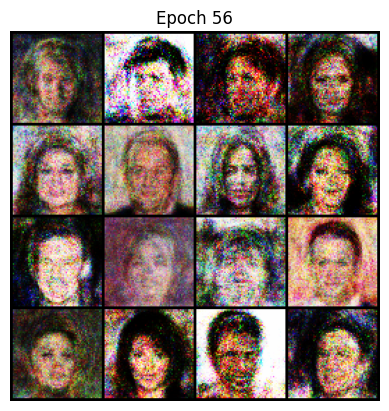

[Epoch 57/100] [Batch 0/1583] [D loss: 0.49368777871131897] [G loss: 1.6024820804595947]
[Epoch 57/100] [Batch 50/1583] [D loss: 0.5212459564208984] [G loss: 1.3475990295410156]
[Epoch 57/100] [Batch 100/1583] [D loss: 0.4697033166885376] [G loss: 1.4150331020355225]
[Epoch 57/100] [Batch 150/1583] [D loss: 0.47625574469566345] [G loss: 1.4683964252471924]
[Epoch 57/100] [Batch 200/1583] [D loss: 0.45465075969696045] [G loss: 1.328482747077942]
[Epoch 57/100] [Batch 250/1583] [D loss: 0.4258299767971039] [G loss: 1.3575541973114014]
[Epoch 57/100] [Batch 300/1583] [D loss: 0.521115779876709] [G loss: 1.24153470993042]
[Epoch 57/100] [Batch 350/1583] [D loss: 0.46678274869918823] [G loss: 1.3747873306274414]
[Epoch 57/100] [Batch 400/1583] [D loss: 0.5025629997253418] [G loss: 1.5598621368408203]
[Epoch 57/100] [Batch 450/1583] [D loss: 0.5191361904144287] [G loss: 1.3580331802368164]
[Epoch 57/100] [Batch 500/1583] [D loss: 0.5005649328231812] [G loss: 1.463233232498169]
[Epoch 57/100]

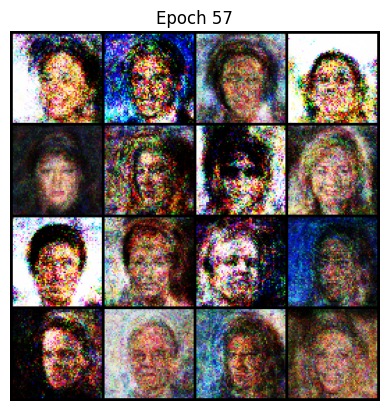

[Epoch 58/100] [Batch 0/1583] [D loss: 0.47532859444618225] [G loss: 1.5923420190811157]
[Epoch 58/100] [Batch 50/1583] [D loss: 0.5047018527984619] [G loss: 1.4359586238861084]
[Epoch 58/100] [Batch 100/1583] [D loss: 0.5266104340553284] [G loss: 1.3414340019226074]
[Epoch 58/100] [Batch 150/1583] [D loss: 0.5273607969284058] [G loss: 1.4870662689208984]
[Epoch 58/100] [Batch 200/1583] [D loss: 0.5191657543182373] [G loss: 1.5577301979064941]
[Epoch 58/100] [Batch 250/1583] [D loss: 0.530186653137207] [G loss: 1.2547693252563477]
[Epoch 58/100] [Batch 300/1583] [D loss: 0.5385206937789917] [G loss: 1.3621947765350342]
[Epoch 58/100] [Batch 350/1583] [D loss: 0.5005163550376892] [G loss: 1.275998830795288]
[Epoch 58/100] [Batch 400/1583] [D loss: 0.5106872320175171] [G loss: 1.2481484413146973]
[Epoch 58/100] [Batch 450/1583] [D loss: 0.5031912326812744] [G loss: 1.454249620437622]
[Epoch 58/100] [Batch 500/1583] [D loss: 0.5210537910461426] [G loss: 1.3774350881576538]
[Epoch 58/100] 

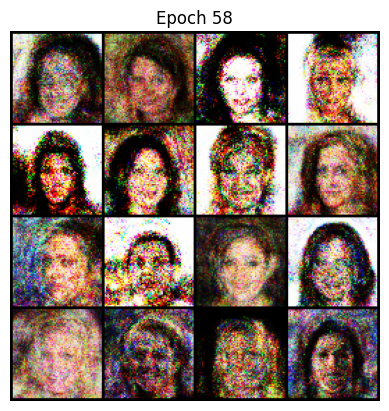

[Epoch 59/100] [Batch 0/1583] [D loss: 0.4748982787132263] [G loss: 1.411264181137085]
[Epoch 59/100] [Batch 50/1583] [D loss: 0.4399217367172241] [G loss: 1.351011037826538]
[Epoch 59/100] [Batch 100/1583] [D loss: 0.43518152832984924] [G loss: 1.395444631576538]
[Epoch 59/100] [Batch 150/1583] [D loss: 0.49958133697509766] [G loss: 1.4030957221984863]
[Epoch 59/100] [Batch 200/1583] [D loss: 0.5011955499649048] [G loss: 1.3932383060455322]
[Epoch 59/100] [Batch 250/1583] [D loss: 0.537320077419281] [G loss: 1.2901917695999146]
[Epoch 59/100] [Batch 300/1583] [D loss: 0.5349017381668091] [G loss: 1.5165661573410034]
[Epoch 59/100] [Batch 350/1583] [D loss: 0.5130030512809753] [G loss: 1.435197114944458]
[Epoch 59/100] [Batch 400/1583] [D loss: 0.4687606692314148] [G loss: 1.4250916242599487]
[Epoch 59/100] [Batch 450/1583] [D loss: 0.5381893515586853] [G loss: 1.3175735473632812]
[Epoch 59/100] [Batch 500/1583] [D loss: 0.5274569988250732] [G loss: 1.145308494567871]
[Epoch 59/100] [B

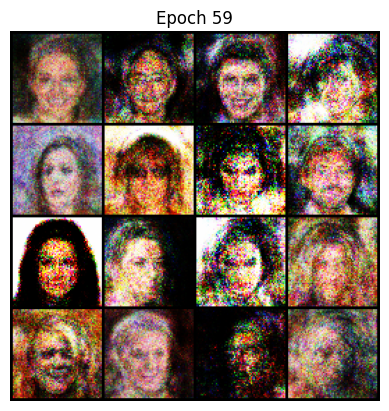

[Epoch 60/100] [Batch 0/1583] [D loss: 0.5345189571380615] [G loss: 1.6274583339691162]
[Epoch 60/100] [Batch 50/1583] [D loss: 0.5345734357833862] [G loss: 1.5176957845687866]
[Epoch 60/100] [Batch 100/1583] [D loss: 0.5214252471923828] [G loss: 1.5442419052124023]
[Epoch 60/100] [Batch 150/1583] [D loss: 0.5011188983917236] [G loss: 1.1998822689056396]
[Epoch 60/100] [Batch 200/1583] [D loss: 0.44240084290504456] [G loss: 1.658554196357727]
[Epoch 60/100] [Batch 250/1583] [D loss: 0.4557017385959625] [G loss: 1.2892327308654785]
[Epoch 60/100] [Batch 300/1583] [D loss: 0.47219759225845337] [G loss: 1.4389766454696655]
[Epoch 60/100] [Batch 350/1583] [D loss: 0.47254207730293274] [G loss: 1.3896335363388062]
[Epoch 60/100] [Batch 400/1583] [D loss: 0.46425771713256836] [G loss: 1.3422651290893555]
[Epoch 60/100] [Batch 450/1583] [D loss: 0.4654809534549713] [G loss: 1.3190089464187622]
[Epoch 60/100] [Batch 500/1583] [D loss: 0.5172463655471802] [G loss: 1.3765199184417725]
[Epoch 60/

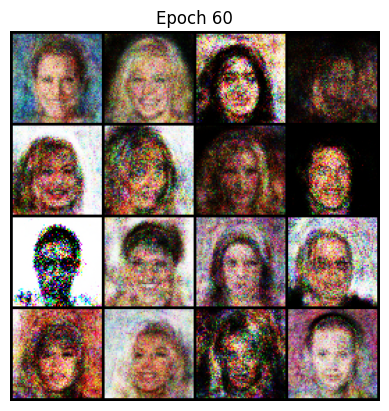

[Epoch 61/100] [Batch 0/1583] [D loss: 0.5130233764648438] [G loss: 1.5434964895248413]
[Epoch 61/100] [Batch 50/1583] [D loss: 0.539417564868927] [G loss: 1.5046555995941162]
[Epoch 61/100] [Batch 100/1583] [D loss: 0.45340782403945923] [G loss: 1.5806185007095337]
[Epoch 61/100] [Batch 150/1583] [D loss: 0.46139824390411377] [G loss: 1.3866608142852783]
[Epoch 61/100] [Batch 200/1583] [D loss: 0.5352866053581238] [G loss: 1.3713898658752441]
[Epoch 61/100] [Batch 250/1583] [D loss: 0.5317481160163879] [G loss: 1.2339606285095215]
[Epoch 61/100] [Batch 300/1583] [D loss: 0.48164433240890503] [G loss: 1.2509379386901855]
[Epoch 61/100] [Batch 350/1583] [D loss: 0.5274512767791748] [G loss: 1.3255366086959839]
[Epoch 61/100] [Batch 400/1583] [D loss: 0.4738902151584625] [G loss: 1.3923559188842773]
[Epoch 61/100] [Batch 450/1583] [D loss: 0.5194674730300903] [G loss: 1.3757290840148926]
[Epoch 61/100] [Batch 500/1583] [D loss: 0.4609006345272064] [G loss: 1.3056567907333374]
[Epoch 61/1

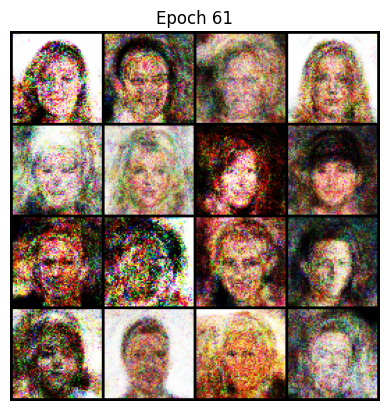

[Epoch 62/100] [Batch 0/1583] [D loss: 0.4894075393676758] [G loss: 1.2069778442382812]
[Epoch 62/100] [Batch 50/1583] [D loss: 0.47389426827430725] [G loss: 1.3781781196594238]
[Epoch 62/100] [Batch 100/1583] [D loss: 0.49035656452178955] [G loss: 1.3661682605743408]
[Epoch 62/100] [Batch 150/1583] [D loss: 0.4425758123397827] [G loss: 1.468430757522583]
[Epoch 62/100] [Batch 200/1583] [D loss: 0.5682282447814941] [G loss: 1.692348599433899]
[Epoch 62/100] [Batch 250/1583] [D loss: 0.49891313910484314] [G loss: 1.6170549392700195]
[Epoch 62/100] [Batch 300/1583] [D loss: 0.5262935757637024] [G loss: 1.3568909168243408]
[Epoch 62/100] [Batch 350/1583] [D loss: 0.46178263425827026] [G loss: 1.2454159259796143]
[Epoch 62/100] [Batch 400/1583] [D loss: 0.5706849098205566] [G loss: 1.3782833814620972]
[Epoch 62/100] [Batch 450/1583] [D loss: 0.5137403011322021] [G loss: 1.5867164134979248]
[Epoch 62/100] [Batch 500/1583] [D loss: 0.5148907899856567] [G loss: 1.2062065601348877]
[Epoch 62/1

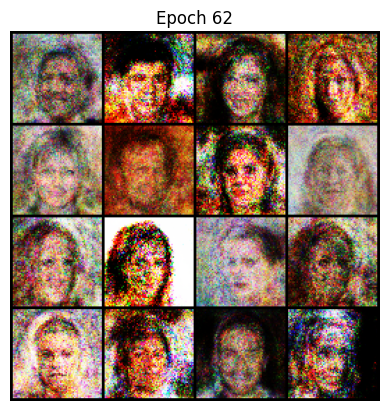

[Epoch 63/100] [Batch 0/1583] [D loss: 0.498870313167572] [G loss: 1.1136895418167114]
[Epoch 63/100] [Batch 50/1583] [D loss: 0.4864063858985901] [G loss: 1.3170663118362427]
[Epoch 63/100] [Batch 100/1583] [D loss: 0.48170456290245056] [G loss: 1.4639036655426025]
[Epoch 63/100] [Batch 150/1583] [D loss: 0.5144301652908325] [G loss: 1.3841757774353027]
[Epoch 63/100] [Batch 200/1583] [D loss: 0.5386070013046265] [G loss: 1.6088495254516602]
[Epoch 63/100] [Batch 250/1583] [D loss: 0.49903881549835205] [G loss: 1.4404817819595337]
[Epoch 63/100] [Batch 300/1583] [D loss: 0.47144097089767456] [G loss: 1.481303334236145]
[Epoch 63/100] [Batch 350/1583] [D loss: 0.5195584297180176] [G loss: 1.4465376138687134]
[Epoch 63/100] [Batch 400/1583] [D loss: 0.5264587998390198] [G loss: 1.584426999092102]
[Epoch 63/100] [Batch 450/1583] [D loss: 0.4449942409992218] [G loss: 1.250551462173462]
[Epoch 63/100] [Batch 500/1583] [D loss: 0.4839324355125427] [G loss: 1.3509974479675293]
[Epoch 63/100]

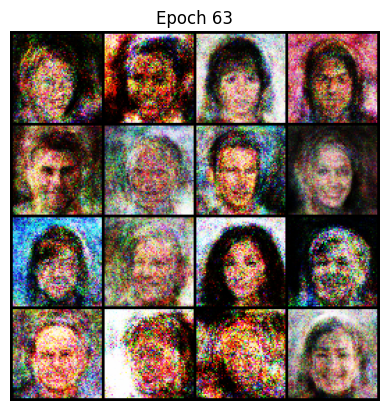

[Epoch 64/100] [Batch 0/1583] [D loss: 0.4981708526611328] [G loss: 1.3921418190002441]
[Epoch 64/100] [Batch 50/1583] [D loss: 0.5462637543678284] [G loss: 1.4684231281280518]
[Epoch 64/100] [Batch 100/1583] [D loss: 0.5002228021621704] [G loss: 1.528172254562378]
[Epoch 64/100] [Batch 150/1583] [D loss: 0.4857290983200073] [G loss: 1.2971311807632446]
[Epoch 64/100] [Batch 200/1583] [D loss: 0.5408862829208374] [G loss: 1.3607032299041748]
[Epoch 64/100] [Batch 250/1583] [D loss: 0.4820767045021057] [G loss: 1.4937222003936768]
[Epoch 64/100] [Batch 300/1583] [D loss: 0.4995614290237427] [G loss: 1.6551475524902344]
[Epoch 64/100] [Batch 350/1583] [D loss: 0.5696755051612854] [G loss: 1.3637726306915283]
[Epoch 64/100] [Batch 400/1583] [D loss: 0.49428606033325195] [G loss: 1.4773249626159668]
[Epoch 64/100] [Batch 450/1583] [D loss: 0.5075911283493042] [G loss: 1.3372743129730225]
[Epoch 64/100] [Batch 500/1583] [D loss: 0.5015065670013428] [G loss: 1.458227515220642]
[Epoch 64/100]

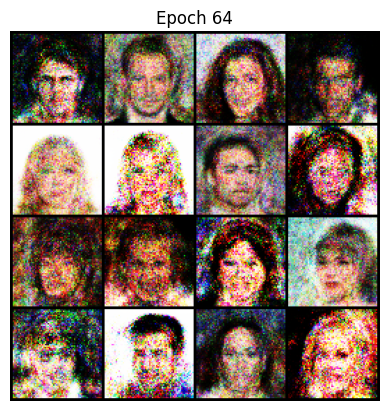

[Epoch 65/100] [Batch 0/1583] [D loss: 0.5355587601661682] [G loss: 1.391279697418213]
[Epoch 65/100] [Batch 50/1583] [D loss: 0.450508177280426] [G loss: 1.3655344247817993]
[Epoch 65/100] [Batch 100/1583] [D loss: 0.4889316260814667] [G loss: 1.3561431169509888]
[Epoch 65/100] [Batch 150/1583] [D loss: 0.48876073956489563] [G loss: 1.4533212184906006]
[Epoch 65/100] [Batch 200/1583] [D loss: 0.5170323848724365] [G loss: 1.4925261735916138]
[Epoch 65/100] [Batch 250/1583] [D loss: 0.45710137486457825] [G loss: 1.5101447105407715]
[Epoch 65/100] [Batch 300/1583] [D loss: 0.48935627937316895] [G loss: 1.4346588850021362]
[Epoch 65/100] [Batch 350/1583] [D loss: 0.47249794006347656] [G loss: 1.1480028629302979]
[Epoch 65/100] [Batch 400/1583] [D loss: 0.5067055225372314] [G loss: 1.4280046224594116]
[Epoch 65/100] [Batch 450/1583] [D loss: 0.5487850904464722] [G loss: 1.3922308683395386]
[Epoch 65/100] [Batch 500/1583] [D loss: 0.4795228838920593] [G loss: 1.4414105415344238]
[Epoch 65/1

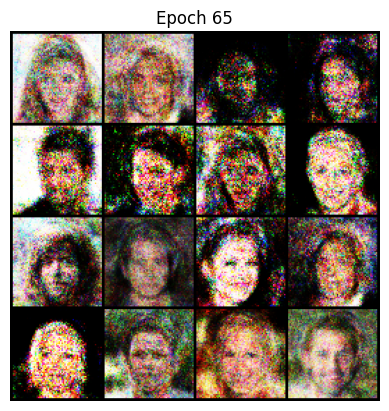

[Epoch 66/100] [Batch 0/1583] [D loss: 0.5561328530311584] [G loss: 1.5271754264831543]
[Epoch 66/100] [Batch 50/1583] [D loss: 0.5547431707382202] [G loss: 1.444018840789795]
[Epoch 66/100] [Batch 100/1583] [D loss: 0.4733494818210602] [G loss: 1.6025099754333496]
[Epoch 66/100] [Batch 150/1583] [D loss: 0.49654823541641235] [G loss: 1.4290846586227417]
[Epoch 66/100] [Batch 200/1583] [D loss: 0.4919285774230957] [G loss: 1.50020432472229]
[Epoch 66/100] [Batch 250/1583] [D loss: 0.49302002787590027] [G loss: 1.3183271884918213]
[Epoch 66/100] [Batch 300/1583] [D loss: 0.45382171869277954] [G loss: 1.294344425201416]
[Epoch 66/100] [Batch 350/1583] [D loss: 0.5080613493919373] [G loss: 1.3869112730026245]
[Epoch 66/100] [Batch 400/1583] [D loss: 0.5654494166374207] [G loss: 1.3442600965499878]
[Epoch 66/100] [Batch 450/1583] [D loss: 0.4787360429763794] [G loss: 1.3796076774597168]
[Epoch 66/100] [Batch 500/1583] [D loss: 0.5275794267654419] [G loss: 1.1350531578063965]
[Epoch 66/100]

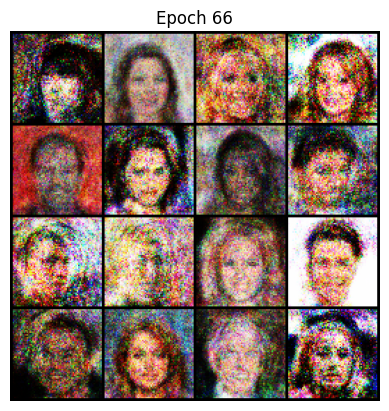

[Epoch 67/100] [Batch 0/1583] [D loss: 0.5277367830276489] [G loss: 1.506259799003601]
[Epoch 67/100] [Batch 50/1583] [D loss: 0.4950629472732544] [G loss: 1.4782160520553589]
[Epoch 67/100] [Batch 100/1583] [D loss: 0.5375916957855225] [G loss: 1.3361010551452637]
[Epoch 67/100] [Batch 150/1583] [D loss: 0.4431890547275543] [G loss: 1.3451006412506104]
[Epoch 67/100] [Batch 200/1583] [D loss: 0.4931027591228485] [G loss: 1.399612545967102]
[Epoch 67/100] [Batch 250/1583] [D loss: 0.5397028923034668] [G loss: 1.484758734703064]
[Epoch 67/100] [Batch 300/1583] [D loss: 0.5524078607559204] [G loss: 1.4114818572998047]
[Epoch 67/100] [Batch 350/1583] [D loss: 0.4512734115123749] [G loss: 1.4010679721832275]
[Epoch 67/100] [Batch 400/1583] [D loss: 0.5124616622924805] [G loss: 1.231390118598938]
[Epoch 67/100] [Batch 450/1583] [D loss: 0.5145718455314636] [G loss: 1.462525725364685]
[Epoch 67/100] [Batch 500/1583] [D loss: 0.4763827919960022] [G loss: 1.3954002857208252]
[Epoch 67/100] [Ba

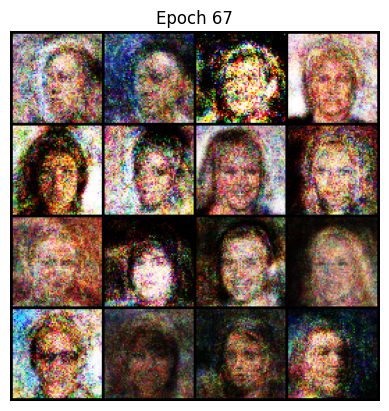

[Epoch 68/100] [Batch 0/1583] [D loss: 0.49422550201416016] [G loss: 1.4228514432907104]
[Epoch 68/100] [Batch 50/1583] [D loss: 0.4806610345840454] [G loss: 1.2412608861923218]
[Epoch 68/100] [Batch 100/1583] [D loss: 0.503020167350769] [G loss: 1.5837645530700684]
[Epoch 68/100] [Batch 150/1583] [D loss: 0.5463589429855347] [G loss: 1.39622163772583]
[Epoch 68/100] [Batch 200/1583] [D loss: 0.5421838760375977] [G loss: 1.2143185138702393]
[Epoch 68/100] [Batch 250/1583] [D loss: 0.5316521525382996] [G loss: 1.3090420961380005]
[Epoch 68/100] [Batch 300/1583] [D loss: 0.4696680009365082] [G loss: 1.3494199514389038]
[Epoch 68/100] [Batch 350/1583] [D loss: 0.4574560225009918] [G loss: 1.4058154821395874]
[Epoch 68/100] [Batch 400/1583] [D loss: 0.47172850370407104] [G loss: 1.600080966949463]
[Epoch 68/100] [Batch 450/1583] [D loss: 0.5309368371963501] [G loss: 1.4181582927703857]
[Epoch 68/100] [Batch 500/1583] [D loss: 0.4637729525566101] [G loss: 1.4368479251861572]
[Epoch 68/100] 

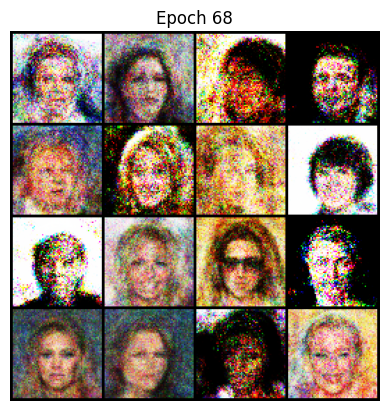

[Epoch 69/100] [Batch 0/1583] [D loss: 0.4845438599586487] [G loss: 1.3248906135559082]
[Epoch 69/100] [Batch 50/1583] [D loss: 0.49169763922691345] [G loss: 1.645796775817871]
[Epoch 69/100] [Batch 100/1583] [D loss: 0.48290228843688965] [G loss: 1.2904386520385742]
[Epoch 69/100] [Batch 150/1583] [D loss: 0.7274547219276428] [G loss: 1.366631031036377]
[Epoch 69/100] [Batch 200/1583] [D loss: 0.5184986591339111] [G loss: 1.6353271007537842]
[Epoch 69/100] [Batch 250/1583] [D loss: 0.5439519882202148] [G loss: 1.322791576385498]
[Epoch 69/100] [Batch 300/1583] [D loss: 0.4373709261417389] [G loss: 1.4091907739639282]
[Epoch 69/100] [Batch 350/1583] [D loss: 0.5348955988883972] [G loss: 1.2500487565994263]
[Epoch 69/100] [Batch 400/1583] [D loss: 0.4694311022758484] [G loss: 1.3868837356567383]
[Epoch 69/100] [Batch 450/1583] [D loss: 0.42912012338638306] [G loss: 1.7060524225234985]
[Epoch 69/100] [Batch 500/1583] [D loss: 0.4436740279197693] [G loss: 1.3115938901901245]
[Epoch 69/100

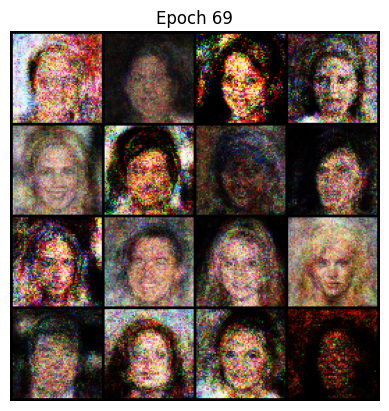

[Epoch 70/100] [Batch 0/1583] [D loss: 0.4657016694545746] [G loss: 1.6216614246368408]
[Epoch 70/100] [Batch 50/1583] [D loss: 0.44757261872291565] [G loss: 1.400437831878662]
[Epoch 70/100] [Batch 100/1583] [D loss: 0.4776957035064697] [G loss: 1.3587478399276733]
[Epoch 70/100] [Batch 150/1583] [D loss: 0.49022114276885986] [G loss: 1.3955199718475342]
[Epoch 70/100] [Batch 200/1583] [D loss: 0.46445709466934204] [G loss: 1.5718899965286255]
[Epoch 70/100] [Batch 250/1583] [D loss: 0.5562909245491028] [G loss: 1.6917483806610107]
[Epoch 70/100] [Batch 300/1583] [D loss: 0.517607569694519] [G loss: 1.6578482389450073]
[Epoch 70/100] [Batch 350/1583] [D loss: 0.4855659008026123] [G loss: 1.3644925355911255]
[Epoch 70/100] [Batch 400/1583] [D loss: 0.4912707805633545] [G loss: 1.5455716848373413]
[Epoch 70/100] [Batch 450/1583] [D loss: 0.541214108467102] [G loss: 1.2444677352905273]
[Epoch 70/100] [Batch 500/1583] [D loss: 0.4745412766933441] [G loss: 1.458618402481079]
[Epoch 70/100]

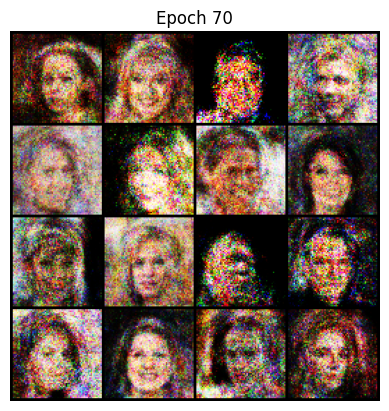

[Epoch 71/100] [Batch 0/1583] [D loss: 0.5147694945335388] [G loss: 1.3745720386505127]
[Epoch 71/100] [Batch 50/1583] [D loss: 0.4320809841156006] [G loss: 1.2989016771316528]
[Epoch 71/100] [Batch 100/1583] [D loss: 0.47756248712539673] [G loss: 1.5595567226409912]
[Epoch 71/100] [Batch 150/1583] [D loss: 0.5268712043762207] [G loss: 1.5205801725387573]
[Epoch 71/100] [Batch 200/1583] [D loss: 0.4880778193473816] [G loss: 1.253068447113037]
[Epoch 71/100] [Batch 250/1583] [D loss: 0.5529112219810486] [G loss: 1.6159653663635254]
[Epoch 71/100] [Batch 300/1583] [D loss: 0.4702242314815521] [G loss: 1.4864211082458496]
[Epoch 71/100] [Batch 350/1583] [D loss: 0.42530888319015503] [G loss: 1.5838327407836914]
[Epoch 71/100] [Batch 400/1583] [D loss: 0.47464311122894287] [G loss: 1.2006609439849854]
[Epoch 71/100] [Batch 450/1583] [D loss: 0.5049093961715698] [G loss: 1.6919633150100708]
[Epoch 71/100] [Batch 500/1583] [D loss: 0.5196876525878906] [G loss: 1.6051764488220215]
[Epoch 71/1

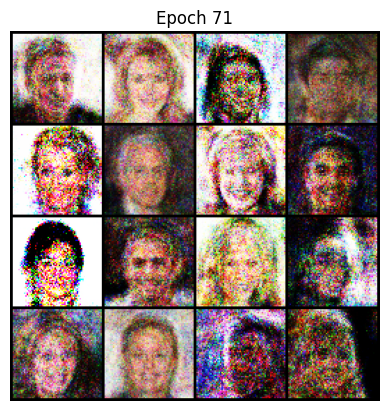

[Epoch 72/100] [Batch 0/1583] [D loss: 0.47168469429016113] [G loss: 1.3608781099319458]
[Epoch 72/100] [Batch 50/1583] [D loss: 0.4653230607509613] [G loss: 1.5410504341125488]
[Epoch 72/100] [Batch 100/1583] [D loss: 0.489952027797699] [G loss: 1.6121666431427002]
[Epoch 72/100] [Batch 150/1583] [D loss: 0.502367377281189] [G loss: 1.4699914455413818]
[Epoch 72/100] [Batch 200/1583] [D loss: 0.4735737442970276] [G loss: 1.5457673072814941]
[Epoch 72/100] [Batch 250/1583] [D loss: 0.5114028453826904] [G loss: 1.4789007902145386]
[Epoch 72/100] [Batch 300/1583] [D loss: 0.4809117317199707] [G loss: 1.4650275707244873]
[Epoch 72/100] [Batch 350/1583] [D loss: 0.45246225595474243] [G loss: 1.4059596061706543]
[Epoch 72/100] [Batch 400/1583] [D loss: 0.5675061941146851] [G loss: 1.3293752670288086]
[Epoch 72/100] [Batch 450/1583] [D loss: 0.5418508052825928] [G loss: 1.327214002609253]
[Epoch 72/100] [Batch 500/1583] [D loss: 0.47377270460128784] [G loss: 1.5101934671401978]
[Epoch 72/100

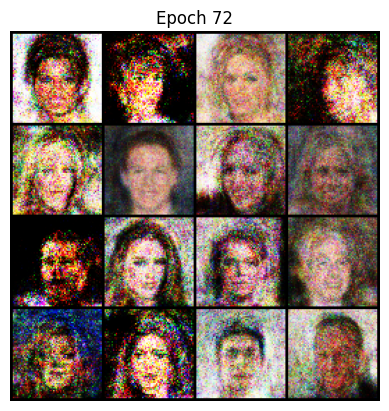

[Epoch 73/100] [Batch 0/1583] [D loss: 0.4918643534183502] [G loss: 1.358303189277649]
[Epoch 73/100] [Batch 50/1583] [D loss: 0.4546812176704407] [G loss: 1.3885658979415894]
[Epoch 73/100] [Batch 100/1583] [D loss: 0.504955530166626] [G loss: 1.552253246307373]
[Epoch 73/100] [Batch 150/1583] [D loss: 0.5060280561447144] [G loss: 1.2122083902359009]
[Epoch 73/100] [Batch 200/1583] [D loss: 0.5169847011566162] [G loss: 1.361472487449646]
[Epoch 73/100] [Batch 250/1583] [D loss: 0.5187187194824219] [G loss: 1.3924363851547241]
[Epoch 73/100] [Batch 300/1583] [D loss: 0.5061089992523193] [G loss: 1.468493938446045]
[Epoch 73/100] [Batch 350/1583] [D loss: 0.5028113126754761] [G loss: 1.7656829357147217]
[Epoch 73/100] [Batch 400/1583] [D loss: 0.4732949137687683] [G loss: 1.4770582914352417]
[Epoch 73/100] [Batch 450/1583] [D loss: 0.573075532913208] [G loss: 1.4340598583221436]
[Epoch 73/100] [Batch 500/1583] [D loss: 0.5024521350860596] [G loss: 1.3881592750549316]
[Epoch 73/100] [Bat

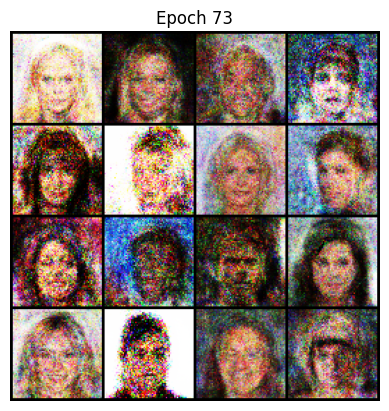

[Epoch 74/100] [Batch 0/1583] [D loss: 0.5113841891288757] [G loss: 1.5148322582244873]
[Epoch 74/100] [Batch 50/1583] [D loss: 0.5702344179153442] [G loss: 1.445833683013916]
[Epoch 74/100] [Batch 100/1583] [D loss: 0.45878148078918457] [G loss: 1.2922487258911133]
[Epoch 74/100] [Batch 150/1583] [D loss: 0.5434538125991821] [G loss: 1.3450615406036377]
[Epoch 74/100] [Batch 200/1583] [D loss: 0.4913181662559509] [G loss: 1.243903398513794]
[Epoch 74/100] [Batch 250/1583] [D loss: 0.558274507522583] [G loss: 1.254276990890503]
[Epoch 74/100] [Batch 300/1583] [D loss: 0.4862039089202881] [G loss: 1.3414782285690308]
[Epoch 74/100] [Batch 350/1583] [D loss: 0.5467395782470703] [G loss: 1.226546287536621]
[Epoch 74/100] [Batch 400/1583] [D loss: 0.4129524230957031] [G loss: 1.4224424362182617]
[Epoch 74/100] [Batch 450/1583] [D loss: 0.4519251883029938] [G loss: 1.3580869436264038]
[Epoch 74/100] [Batch 500/1583] [D loss: 0.4968571066856384] [G loss: 1.516835331916809]
[Epoch 74/100] [Ba

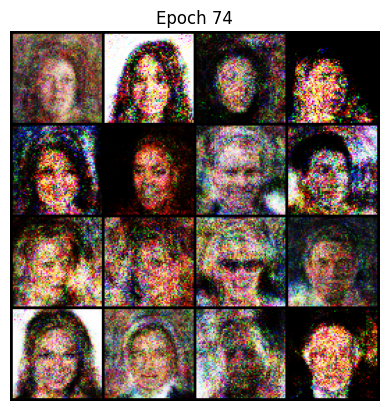

[Epoch 75/100] [Batch 0/1583] [D loss: 0.5051681995391846] [G loss: 1.1877473592758179]
[Epoch 75/100] [Batch 50/1583] [D loss: 0.451351523399353] [G loss: 1.6578826904296875]
[Epoch 75/100] [Batch 100/1583] [D loss: 0.4787713289260864] [G loss: 1.2923338413238525]
[Epoch 75/100] [Batch 150/1583] [D loss: 0.5548122525215149] [G loss: 1.2377007007598877]
[Epoch 75/100] [Batch 200/1583] [D loss: 0.49895039200782776] [G loss: 1.580094337463379]
[Epoch 75/100] [Batch 250/1583] [D loss: 0.5598511695861816] [G loss: 1.4017162322998047]
[Epoch 75/100] [Batch 300/1583] [D loss: 0.487643837928772] [G loss: 1.3790353536605835]
[Epoch 75/100] [Batch 350/1583] [D loss: 0.48707300424575806] [G loss: 1.4729886054992676]
[Epoch 75/100] [Batch 400/1583] [D loss: 0.5159803032875061] [G loss: 1.4870736598968506]
[Epoch 75/100] [Batch 450/1583] [D loss: 0.44257092475891113] [G loss: 1.4218783378601074]
[Epoch 75/100] [Batch 500/1583] [D loss: 0.4787711501121521] [G loss: 1.389173984527588]
[Epoch 75/100]

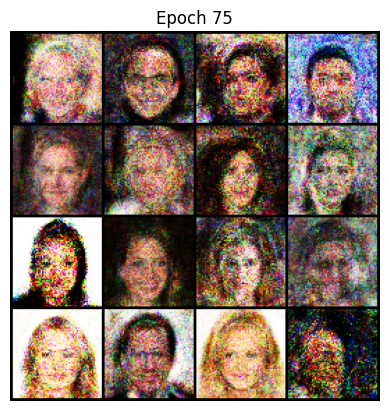

[Epoch 76/100] [Batch 0/1583] [D loss: 0.4769868552684784] [G loss: 1.3299975395202637]
[Epoch 76/100] [Batch 50/1583] [D loss: 0.5199254155158997] [G loss: 1.3852330446243286]
[Epoch 76/100] [Batch 100/1583] [D loss: 0.5120100378990173] [G loss: 1.4475924968719482]
[Epoch 76/100] [Batch 150/1583] [D loss: 0.5597972273826599] [G loss: 1.3735448122024536]
[Epoch 76/100] [Batch 200/1583] [D loss: 0.46679064631462097] [G loss: 1.540685772895813]
[Epoch 76/100] [Batch 250/1583] [D loss: 0.5429444313049316] [G loss: 1.3821852207183838]
[Epoch 76/100] [Batch 300/1583] [D loss: 0.4914020299911499] [G loss: 1.4675005674362183]
[Epoch 76/100] [Batch 350/1583] [D loss: 0.5841426253318787] [G loss: 1.4235560894012451]
[Epoch 76/100] [Batch 400/1583] [D loss: 0.4397931694984436] [G loss: 1.6002349853515625]
[Epoch 76/100] [Batch 450/1583] [D loss: 0.4716618061065674] [G loss: 1.2375928163528442]
[Epoch 76/100] [Batch 500/1583] [D loss: 0.4679747521877289] [G loss: 1.3547523021697998]
[Epoch 76/100

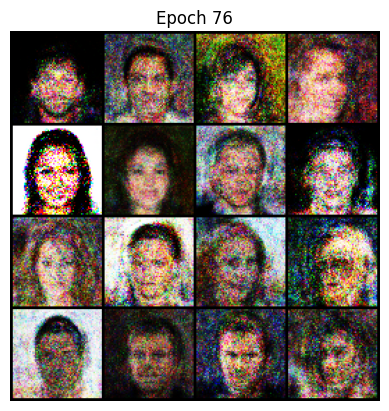

[Epoch 77/100] [Batch 0/1583] [D loss: 0.5406976938247681] [G loss: 1.3968143463134766]
[Epoch 77/100] [Batch 50/1583] [D loss: 0.47535914182662964] [G loss: 1.4076085090637207]
[Epoch 77/100] [Batch 100/1583] [D loss: 0.4919224977493286] [G loss: 1.3704148530960083]
[Epoch 77/100] [Batch 150/1583] [D loss: 0.4895680546760559] [G loss: 1.5297691822052002]
[Epoch 77/100] [Batch 200/1583] [D loss: 0.486543744802475] [G loss: 1.3271305561065674]
[Epoch 77/100] [Batch 250/1583] [D loss: 0.5105020999908447] [G loss: 1.3551945686340332]
[Epoch 77/100] [Batch 300/1583] [D loss: 0.4744422733783722] [G loss: 1.5569031238555908]
[Epoch 77/100] [Batch 350/1583] [D loss: 0.5227494239807129] [G loss: 1.496631145477295]
[Epoch 77/100] [Batch 400/1583] [D loss: 0.49122700095176697] [G loss: 1.5157030820846558]
[Epoch 77/100] [Batch 450/1583] [D loss: 0.49187570810317993] [G loss: 1.3862857818603516]
[Epoch 77/100] [Batch 500/1583] [D loss: 0.49554356932640076] [G loss: 1.3390792608261108]
[Epoch 77/1

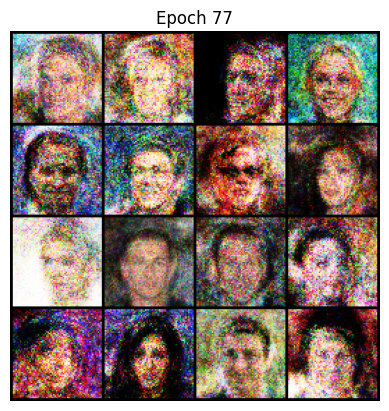

[Epoch 78/100] [Batch 0/1583] [D loss: 0.4535655975341797] [G loss: 1.318308711051941]
[Epoch 78/100] [Batch 50/1583] [D loss: 0.4962039589881897] [G loss: 1.3263578414916992]
[Epoch 78/100] [Batch 100/1583] [D loss: 0.49425008893013] [G loss: 1.427335500717163]
[Epoch 78/100] [Batch 150/1583] [D loss: 0.5274225473403931] [G loss: 1.3218157291412354]
[Epoch 78/100] [Batch 200/1583] [D loss: 0.44725051522254944] [G loss: 1.3531559705734253]
[Epoch 78/100] [Batch 250/1583] [D loss: 0.5013341903686523] [G loss: 1.5225669145584106]
[Epoch 78/100] [Batch 300/1583] [D loss: 0.6022257208824158] [G loss: 1.202942967414856]
[Epoch 78/100] [Batch 350/1583] [D loss: 0.4537125825881958] [G loss: 1.4548194408416748]
[Epoch 78/100] [Batch 400/1583] [D loss: 0.4706166386604309] [G loss: 1.5625429153442383]
[Epoch 78/100] [Batch 450/1583] [D loss: 0.5247798562049866] [G loss: 1.375147819519043]
[Epoch 78/100] [Batch 500/1583] [D loss: 0.5459192991256714] [G loss: 1.2061406373977661]
[Epoch 78/100] [Ba

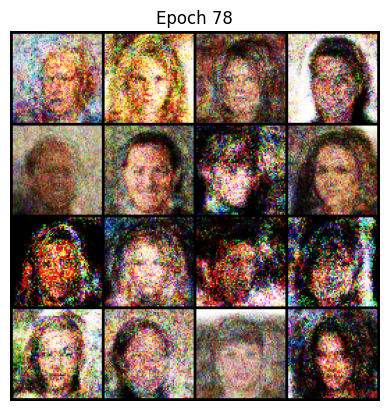

[Epoch 79/100] [Batch 0/1583] [D loss: 0.46902406215667725] [G loss: 1.446217656135559]
[Epoch 79/100] [Batch 50/1583] [D loss: 0.48345947265625] [G loss: 1.300576090812683]
[Epoch 79/100] [Batch 100/1583] [D loss: 0.4499565362930298] [G loss: 1.5563074350357056]
[Epoch 79/100] [Batch 150/1583] [D loss: 0.4622073769569397] [G loss: 1.2620660066604614]
[Epoch 79/100] [Batch 200/1583] [D loss: 0.5370442271232605] [G loss: 1.4835641384124756]
[Epoch 79/100] [Batch 250/1583] [D loss: 0.5198911428451538] [G loss: 1.5510430335998535]
[Epoch 79/100] [Batch 300/1583] [D loss: 0.528658390045166] [G loss: 1.2252733707427979]
[Epoch 79/100] [Batch 350/1583] [D loss: 0.5079813003540039] [G loss: 1.2678580284118652]
[Epoch 79/100] [Batch 400/1583] [D loss: 0.5589059591293335] [G loss: 1.43708074092865]
[Epoch 79/100] [Batch 450/1583] [D loss: 0.5064926743507385] [G loss: 1.3858839273452759]
[Epoch 79/100] [Batch 500/1583] [D loss: 0.4923245310783386] [G loss: 1.4670746326446533]
[Epoch 79/100] [Bat

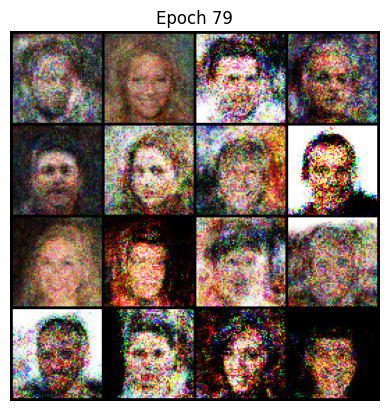

[Epoch 80/100] [Batch 0/1583] [D loss: 0.5572775602340698] [G loss: 1.2052984237670898]
[Epoch 80/100] [Batch 50/1583] [D loss: 0.5482162833213806] [G loss: 1.2834572792053223]
[Epoch 80/100] [Batch 100/1583] [D loss: 0.49442076683044434] [G loss: 1.5402824878692627]
[Epoch 80/100] [Batch 150/1583] [D loss: 0.4457536041736603] [G loss: 1.4204003810882568]
[Epoch 80/100] [Batch 200/1583] [D loss: 0.5558188557624817] [G loss: 1.284610390663147]
[Epoch 80/100] [Batch 250/1583] [D loss: 0.48469164967536926] [G loss: 1.1515593528747559]
[Epoch 80/100] [Batch 300/1583] [D loss: 0.5186810493469238] [G loss: 1.3805222511291504]
[Epoch 80/100] [Batch 350/1583] [D loss: 0.5683767199516296] [G loss: 1.3602774143218994]
[Epoch 80/100] [Batch 400/1583] [D loss: 0.4991975724697113] [G loss: 1.384989619255066]
[Epoch 80/100] [Batch 450/1583] [D loss: 0.4609489440917969] [G loss: 1.43954598903656]
[Epoch 80/100] [Batch 500/1583] [D loss: 0.530185341835022] [G loss: 1.5507595539093018]
[Epoch 80/100] [

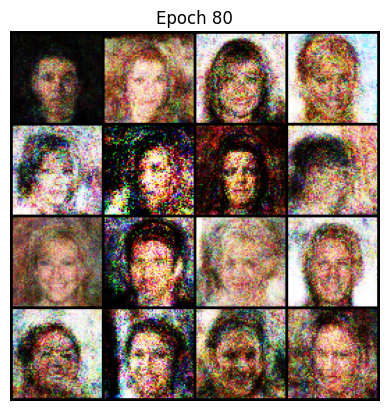

[Epoch 81/100] [Batch 0/1583] [D loss: 0.5148520469665527] [G loss: 1.2051689624786377]
[Epoch 81/100] [Batch 50/1583] [D loss: 0.5124088525772095] [G loss: 1.551564335823059]
[Epoch 81/100] [Batch 100/1583] [D loss: 0.48970726132392883] [G loss: 1.3890557289123535]
[Epoch 81/100] [Batch 150/1583] [D loss: 0.48832643032073975] [G loss: 1.4208319187164307]
[Epoch 81/100] [Batch 200/1583] [D loss: 0.5228805541992188] [G loss: 1.481722116470337]
[Epoch 81/100] [Batch 250/1583] [D loss: 0.5151728987693787] [G loss: 1.4516932964324951]
[Epoch 81/100] [Batch 300/1583] [D loss: 0.46861493587493896] [G loss: 1.4513095617294312]
[Epoch 81/100] [Batch 350/1583] [D loss: 0.5169843435287476] [G loss: 1.0768611431121826]
[Epoch 81/100] [Batch 400/1583] [D loss: 0.548490047454834] [G loss: 1.280991792678833]
[Epoch 81/100] [Batch 450/1583] [D loss: 0.499457448720932] [G loss: 1.3049135208129883]
[Epoch 81/100] [Batch 500/1583] [D loss: 0.46437352895736694] [G loss: 1.4719018936157227]
[Epoch 81/100]

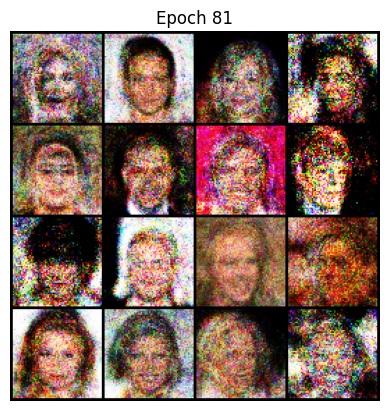

[Epoch 82/100] [Batch 0/1583] [D loss: 0.48357459902763367] [G loss: 1.3488459587097168]
[Epoch 82/100] [Batch 50/1583] [D loss: 0.5620929598808289] [G loss: 1.5898730754852295]
[Epoch 82/100] [Batch 100/1583] [D loss: 0.4622045159339905] [G loss: 1.3139042854309082]
[Epoch 82/100] [Batch 150/1583] [D loss: 0.5460307598114014] [G loss: 1.3097953796386719]
[Epoch 82/100] [Batch 200/1583] [D loss: 0.5224953293800354] [G loss: 1.4580904245376587]
[Epoch 82/100] [Batch 250/1583] [D loss: 0.4756767749786377] [G loss: 1.430621862411499]
[Epoch 82/100] [Batch 300/1583] [D loss: 0.514817476272583] [G loss: 1.3493640422821045]
[Epoch 82/100] [Batch 350/1583] [D loss: 0.4367985427379608] [G loss: 1.4579564332962036]
[Epoch 82/100] [Batch 400/1583] [D loss: 0.47285929322242737] [G loss: 1.3811986446380615]
[Epoch 82/100] [Batch 450/1583] [D loss: 0.5447040796279907] [G loss: 1.3444299697875977]
[Epoch 82/100] [Batch 500/1583] [D loss: 0.516038179397583] [G loss: 1.4875653982162476]
[Epoch 82/100]

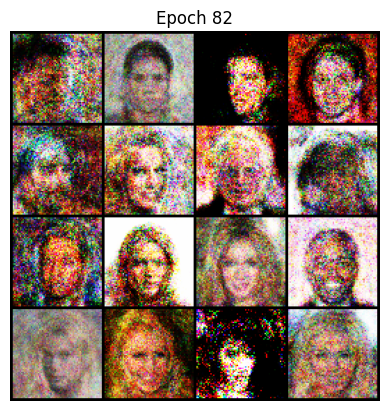

[Epoch 83/100] [Batch 0/1583] [D loss: 0.49588340520858765] [G loss: 1.3514740467071533]
[Epoch 83/100] [Batch 50/1583] [D loss: 0.44344523549079895] [G loss: 1.2887511253356934]
[Epoch 83/100] [Batch 100/1583] [D loss: 0.5477474927902222] [G loss: 1.262721061706543]
[Epoch 83/100] [Batch 150/1583] [D loss: 0.4831472635269165] [G loss: 1.391438603401184]
[Epoch 83/100] [Batch 200/1583] [D loss: 0.5416856408119202] [G loss: 1.7245681285858154]
[Epoch 83/100] [Batch 250/1583] [D loss: 0.4977610111236572] [G loss: 1.3933525085449219]
[Epoch 83/100] [Batch 300/1583] [D loss: 0.5178511738777161] [G loss: 1.3313864469528198]
[Epoch 83/100] [Batch 350/1583] [D loss: 0.4936329126358032] [G loss: 1.1843807697296143]
[Epoch 83/100] [Batch 400/1583] [D loss: 0.47493666410446167] [G loss: 1.5361751317977905]
[Epoch 83/100] [Batch 450/1583] [D loss: 0.578392505645752] [G loss: 1.2981629371643066]
[Epoch 83/100] [Batch 500/1583] [D loss: 0.5312396883964539] [G loss: 1.4843082427978516]
[Epoch 83/100

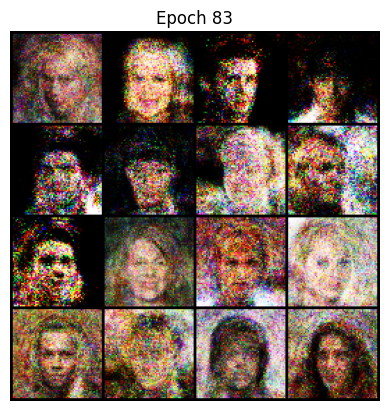

[Epoch 84/100] [Batch 0/1583] [D loss: 0.5236334800720215] [G loss: 1.4893064498901367]
[Epoch 84/100] [Batch 50/1583] [D loss: 0.492607980966568] [G loss: 1.2477937936782837]
[Epoch 84/100] [Batch 100/1583] [D loss: 0.495277464389801] [G loss: 1.3654849529266357]
[Epoch 84/100] [Batch 150/1583] [D loss: 0.5891859531402588] [G loss: 1.286442756652832]
[Epoch 84/100] [Batch 200/1583] [D loss: 0.5150697231292725] [G loss: 1.2418699264526367]
[Epoch 84/100] [Batch 250/1583] [D loss: 0.5090230703353882] [G loss: 1.3154078722000122]
[Epoch 84/100] [Batch 300/1583] [D loss: 0.4750615656375885] [G loss: 1.4224789142608643]
[Epoch 84/100] [Batch 350/1583] [D loss: 0.4902708828449249] [G loss: 1.5219807624816895]
[Epoch 84/100] [Batch 400/1583] [D loss: 0.5022362470626831] [G loss: 1.1577433347702026]
[Epoch 84/100] [Batch 450/1583] [D loss: 0.6327487230300903] [G loss: 1.458092451095581]
[Epoch 84/100] [Batch 500/1583] [D loss: 0.4942818582057953] [G loss: 1.6633245944976807]
[Epoch 84/100] [B

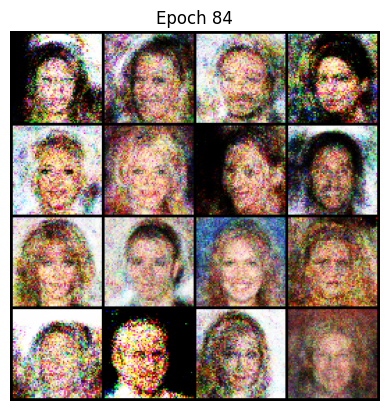

[Epoch 85/100] [Batch 0/1583] [D loss: 0.5158953666687012] [G loss: 1.357057809829712]
[Epoch 85/100] [Batch 50/1583] [D loss: 0.521246612071991] [G loss: 1.4724020957946777]
[Epoch 85/100] [Batch 100/1583] [D loss: 0.4940694570541382] [G loss: 1.5533225536346436]
[Epoch 85/100] [Batch 150/1583] [D loss: 0.5185028910636902] [G loss: 1.248070478439331]
[Epoch 85/100] [Batch 200/1583] [D loss: 0.5696760416030884] [G loss: 1.2566823959350586]
[Epoch 85/100] [Batch 250/1583] [D loss: 0.5266910195350647] [G loss: 1.2734302282333374]
[Epoch 85/100] [Batch 300/1583] [D loss: 0.49678948521614075] [G loss: 1.4057567119598389]
[Epoch 85/100] [Batch 350/1583] [D loss: 0.4851331114768982] [G loss: 1.671080470085144]
[Epoch 85/100] [Batch 400/1583] [D loss: 0.601974606513977] [G loss: 1.5548632144927979]
[Epoch 85/100] [Batch 450/1583] [D loss: 0.48840904235839844] [G loss: 1.3524744510650635]
[Epoch 85/100] [Batch 500/1583] [D loss: 0.45524975657463074] [G loss: 1.5907903909683228]
[Epoch 85/100] 

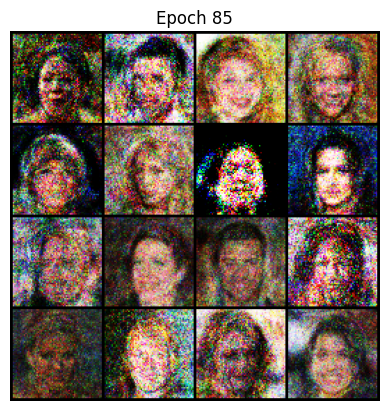

[Epoch 86/100] [Batch 0/1583] [D loss: 0.49743860960006714] [G loss: 1.3387682437896729]
[Epoch 86/100] [Batch 50/1583] [D loss: 0.4417187571525574] [G loss: 1.4325400590896606]
[Epoch 86/100] [Batch 100/1583] [D loss: 0.42277252674102783] [G loss: 1.4730899333953857]
[Epoch 86/100] [Batch 150/1583] [D loss: 0.5139856338500977] [G loss: 1.2975765466690063]
[Epoch 86/100] [Batch 200/1583] [D loss: 0.5240253210067749] [G loss: 1.4469188451766968]
[Epoch 86/100] [Batch 250/1583] [D loss: 0.5073401927947998] [G loss: 1.4281662702560425]
[Epoch 86/100] [Batch 300/1583] [D loss: 0.45953309535980225] [G loss: 1.5023130178451538]
[Epoch 86/100] [Batch 350/1583] [D loss: 0.4649246335029602] [G loss: 1.6322171688079834]
[Epoch 86/100] [Batch 400/1583] [D loss: 0.5198902487754822] [G loss: 1.3584576845169067]
[Epoch 86/100] [Batch 450/1583] [D loss: 0.47875428199768066] [G loss: 1.2568843364715576]
[Epoch 86/100] [Batch 500/1583] [D loss: 0.42753809690475464] [G loss: 1.2436294555664062]
[Epoch 8

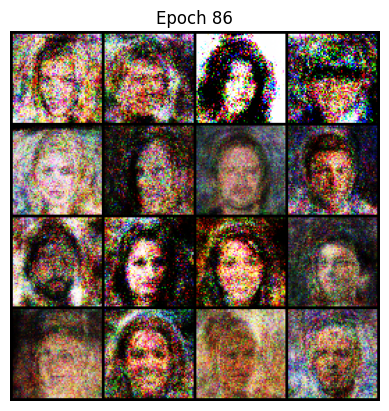

[Epoch 87/100] [Batch 0/1583] [D loss: 0.4683590531349182] [G loss: 1.5543797016143799]
[Epoch 87/100] [Batch 50/1583] [D loss: 0.5213619470596313] [G loss: 1.2012407779693604]
[Epoch 87/100] [Batch 100/1583] [D loss: 0.46330246329307556] [G loss: 1.4747912883758545]
[Epoch 87/100] [Batch 150/1583] [D loss: 0.49933063983917236] [G loss: 1.5250158309936523]
[Epoch 87/100] [Batch 200/1583] [D loss: 0.493784099817276] [G loss: 1.3421204090118408]
[Epoch 87/100] [Batch 250/1583] [D loss: 0.5291225910186768] [G loss: 1.4261407852172852]
[Epoch 87/100] [Batch 300/1583] [D loss: 0.5242079496383667] [G loss: 1.3803761005401611]
[Epoch 87/100] [Batch 350/1583] [D loss: 0.5419257283210754] [G loss: 1.268202781677246]
[Epoch 87/100] [Batch 400/1583] [D loss: 0.5663732290267944] [G loss: 1.5216009616851807]
[Epoch 87/100] [Batch 450/1583] [D loss: 0.4831656813621521] [G loss: 1.5158600807189941]
[Epoch 87/100] [Batch 500/1583] [D loss: 0.4425147771835327] [G loss: 1.4134023189544678]
[Epoch 87/100

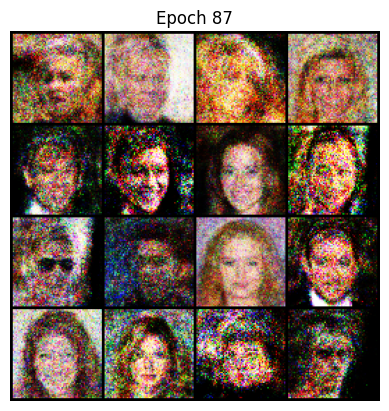

[Epoch 88/100] [Batch 0/1583] [D loss: 0.5837383270263672] [G loss: 1.268947958946228]
[Epoch 88/100] [Batch 50/1583] [D loss: 0.5154294967651367] [G loss: 1.5186536312103271]
[Epoch 88/100] [Batch 100/1583] [D loss: 0.3996138572692871] [G loss: 1.537264347076416]
[Epoch 88/100] [Batch 150/1583] [D loss: 0.4653000831604004] [G loss: 1.306038737297058]
[Epoch 88/100] [Batch 200/1583] [D loss: 0.44660699367523193] [G loss: 1.4759783744812012]
[Epoch 88/100] [Batch 250/1583] [D loss: 0.502923846244812] [G loss: 1.3060284852981567]
[Epoch 88/100] [Batch 300/1583] [D loss: 0.4645695686340332] [G loss: 1.4482982158660889]
[Epoch 88/100] [Batch 350/1583] [D loss: 0.43704289197921753] [G loss: 1.4211937189102173]
[Epoch 88/100] [Batch 400/1583] [D loss: 0.5098182559013367] [G loss: 1.4578461647033691]
[Epoch 88/100] [Batch 450/1583] [D loss: 0.4712998867034912] [G loss: 1.35822594165802]
[Epoch 88/100] [Batch 500/1583] [D loss: 0.463408887386322] [G loss: 1.4164483547210693]
[Epoch 88/100] [Ba

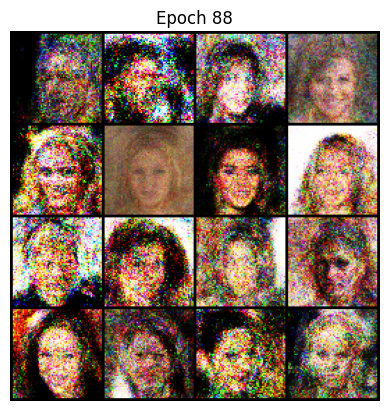

[Epoch 89/100] [Batch 0/1583] [D loss: 0.5193506479263306] [G loss: 1.391209363937378]
[Epoch 89/100] [Batch 50/1583] [D loss: 0.48281165957450867] [G loss: 1.6295547485351562]
[Epoch 89/100] [Batch 100/1583] [D loss: 0.6055220365524292] [G loss: 1.6384117603302002]
[Epoch 89/100] [Batch 150/1583] [D loss: 0.5662890076637268] [G loss: 1.4377654790878296]
[Epoch 89/100] [Batch 200/1583] [D loss: 0.5076265335083008] [G loss: 1.323290467262268]
[Epoch 89/100] [Batch 250/1583] [D loss: 0.5190165638923645] [G loss: 1.2891533374786377]
[Epoch 89/100] [Batch 300/1583] [D loss: 0.5160569548606873] [G loss: 1.3939170837402344]
[Epoch 89/100] [Batch 350/1583] [D loss: 0.474639892578125] [G loss: 1.453881859779358]
[Epoch 89/100] [Batch 400/1583] [D loss: 0.47635796666145325] [G loss: 1.321183204650879]
[Epoch 89/100] [Batch 450/1583] [D loss: 0.6071154475212097] [G loss: 1.3729616403579712]
[Epoch 89/100] [Batch 500/1583] [D loss: 0.5654305219650269] [G loss: 1.16523015499115]
[Epoch 89/100] [Ba

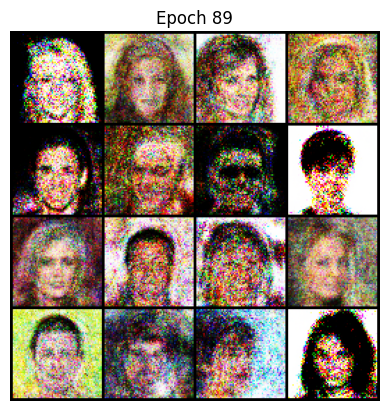

[Epoch 90/100] [Batch 0/1583] [D loss: 0.42498043179512024] [G loss: 1.5624022483825684]
[Epoch 90/100] [Batch 50/1583] [D loss: 0.5339392423629761] [G loss: 1.193084478378296]
[Epoch 90/100] [Batch 100/1583] [D loss: 0.503314733505249] [G loss: 1.7512983083724976]
[Epoch 90/100] [Batch 150/1583] [D loss: 0.44244903326034546] [G loss: 1.3251100778579712]
[Epoch 90/100] [Batch 200/1583] [D loss: 0.4768922030925751] [G loss: 1.5675153732299805]
[Epoch 90/100] [Batch 250/1583] [D loss: 0.5187594890594482] [G loss: 1.3696675300598145]
[Epoch 90/100] [Batch 300/1583] [D loss: 0.4540780484676361] [G loss: 1.4763292074203491]
[Epoch 90/100] [Batch 350/1583] [D loss: 0.4920668601989746] [G loss: 1.4725255966186523]
[Epoch 90/100] [Batch 400/1583] [D loss: 0.578658938407898] [G loss: 1.3261305093765259]
[Epoch 90/100] [Batch 450/1583] [D loss: 0.5444921255111694] [G loss: 1.336562991142273]
[Epoch 90/100] [Batch 500/1583] [D loss: 0.4978391230106354] [G loss: 1.396202564239502]
[Epoch 90/100] [

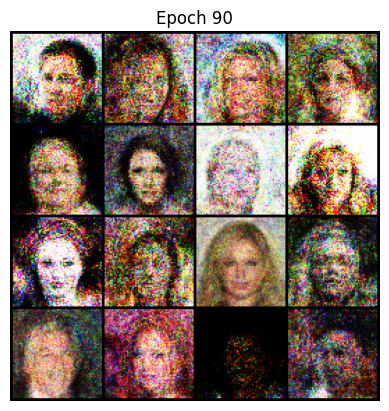

[Epoch 91/100] [Batch 0/1583] [D loss: 0.5161017179489136] [G loss: 1.3762061595916748]
[Epoch 91/100] [Batch 50/1583] [D loss: 0.48791852593421936] [G loss: 1.650173544883728]
[Epoch 91/100] [Batch 100/1583] [D loss: 0.5149922370910645] [G loss: 1.5059245824813843]
[Epoch 91/100] [Batch 150/1583] [D loss: 0.4963717460632324] [G loss: 1.4547839164733887]
[Epoch 91/100] [Batch 200/1583] [D loss: 0.4748813211917877] [G loss: 1.2787461280822754]
[Epoch 91/100] [Batch 250/1583] [D loss: 0.496385782957077] [G loss: 1.3778455257415771]
[Epoch 91/100] [Batch 300/1583] [D loss: 0.48867690563201904] [G loss: 1.4114363193511963]
[Epoch 91/100] [Batch 350/1583] [D loss: 0.502690315246582] [G loss: 1.4738154411315918]
[Epoch 91/100] [Batch 400/1583] [D loss: 0.5449498295783997] [G loss: 1.393043041229248]
[Epoch 91/100] [Batch 450/1583] [D loss: 0.4800862669944763] [G loss: 1.3336663246154785]
[Epoch 91/100] [Batch 500/1583] [D loss: 0.542461633682251] [G loss: 1.2067735195159912]
[Epoch 91/100] [

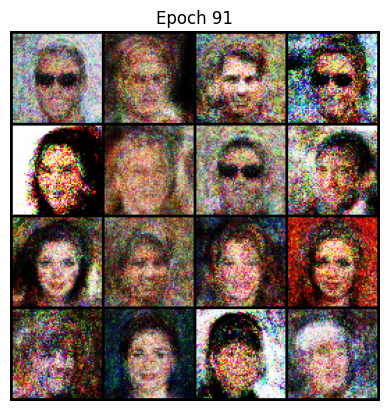

[Epoch 92/100] [Batch 0/1583] [D loss: 0.5822691917419434] [G loss: 1.294588565826416]
[Epoch 92/100] [Batch 50/1583] [D loss: 0.49905532598495483] [G loss: 1.3761475086212158]
[Epoch 92/100] [Batch 100/1583] [D loss: 0.49331337213516235] [G loss: 1.5050015449523926]
[Epoch 92/100] [Batch 150/1583] [D loss: 0.4817922115325928] [G loss: 1.4774131774902344]
[Epoch 92/100] [Batch 200/1583] [D loss: 0.5314935445785522] [G loss: 1.2304860353469849]
[Epoch 92/100] [Batch 250/1583] [D loss: 0.5041714906692505] [G loss: 1.306703805923462]
[Epoch 92/100] [Batch 300/1583] [D loss: 0.5340971946716309] [G loss: 1.2218083143234253]
[Epoch 92/100] [Batch 350/1583] [D loss: 0.47764062881469727] [G loss: 1.3565151691436768]
[Epoch 92/100] [Batch 400/1583] [D loss: 0.5008290410041809] [G loss: 1.1969223022460938]
[Epoch 92/100] [Batch 450/1583] [D loss: 0.519018828868866] [G loss: 1.293906331062317]
[Epoch 92/100] [Batch 500/1583] [D loss: 0.4844183325767517] [G loss: 1.46225905418396]
[Epoch 92/100] [

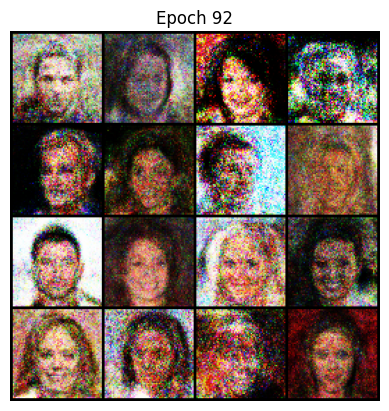

[Epoch 93/100] [Batch 0/1583] [D loss: 0.5195349454879761] [G loss: 1.423250675201416]
[Epoch 93/100] [Batch 50/1583] [D loss: 0.5156024694442749] [G loss: 1.4052742719650269]
[Epoch 93/100] [Batch 100/1583] [D loss: 0.4821397662162781] [G loss: 1.5809434652328491]
[Epoch 93/100] [Batch 150/1583] [D loss: 0.5145295858383179] [G loss: 1.5851095914840698]
[Epoch 93/100] [Batch 200/1583] [D loss: 0.5829108953475952] [G loss: 1.3815170526504517]
[Epoch 93/100] [Batch 250/1583] [D loss: 0.4852743148803711] [G loss: 1.3829423189163208]
[Epoch 93/100] [Batch 300/1583] [D loss: 0.555213451385498] [G loss: 1.2245323657989502]
[Epoch 93/100] [Batch 350/1583] [D loss: 0.509162425994873] [G loss: 1.3789089918136597]
[Epoch 93/100] [Batch 400/1583] [D loss: 0.48160311579704285] [G loss: 1.4974652528762817]
[Epoch 93/100] [Batch 450/1583] [D loss: 0.4770547151565552] [G loss: 1.412210464477539]
[Epoch 93/100] [Batch 500/1583] [D loss: 0.5004565715789795] [G loss: 1.4354116916656494]
[Epoch 93/100] [

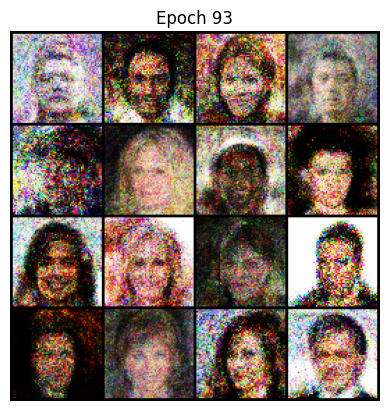

[Epoch 94/100] [Batch 0/1583] [D loss: 0.4803774356842041] [G loss: 1.5499348640441895]
[Epoch 94/100] [Batch 50/1583] [D loss: 0.4621015787124634] [G loss: 1.3124808073043823]
[Epoch 94/100] [Batch 100/1583] [D loss: 0.4680887460708618] [G loss: 1.481290578842163]
[Epoch 94/100] [Batch 150/1583] [D loss: 0.48971372842788696] [G loss: 1.31880784034729]
[Epoch 94/100] [Batch 200/1583] [D loss: 0.5092258453369141] [G loss: 1.3661024570465088]
[Epoch 94/100] [Batch 250/1583] [D loss: 0.4475065767765045] [G loss: 1.5333445072174072]
[Epoch 94/100] [Batch 300/1583] [D loss: 0.5229828357696533] [G loss: 1.6349177360534668]
[Epoch 94/100] [Batch 350/1583] [D loss: 0.4892500042915344] [G loss: 1.464185118675232]
[Epoch 94/100] [Batch 400/1583] [D loss: 0.5089626312255859] [G loss: 1.3573181629180908]
[Epoch 94/100] [Batch 450/1583] [D loss: 0.5312331914901733] [G loss: 1.4269442558288574]
[Epoch 94/100] [Batch 500/1583] [D loss: 0.5483932495117188] [G loss: 1.4081206321716309]
[Epoch 94/100] [

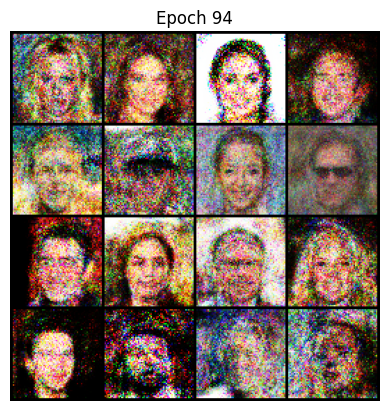

[Epoch 95/100] [Batch 0/1583] [D loss: 0.461005836725235] [G loss: 1.4534111022949219]
[Epoch 95/100] [Batch 50/1583] [D loss: 0.5085265636444092] [G loss: 1.2879974842071533]
[Epoch 95/100] [Batch 100/1583] [D loss: 0.5170202851295471] [G loss: 1.6076053380966187]
[Epoch 95/100] [Batch 150/1583] [D loss: 0.5239953398704529] [G loss: 1.4961903095245361]
[Epoch 95/100] [Batch 200/1583] [D loss: 0.4654653072357178] [G loss: 1.5377658605575562]
[Epoch 95/100] [Batch 250/1583] [D loss: 0.5495858192443848] [G loss: 1.581831932067871]
[Epoch 95/100] [Batch 300/1583] [D loss: 0.44742101430892944] [G loss: 1.3673961162567139]
[Epoch 95/100] [Batch 350/1583] [D loss: 0.5362975001335144] [G loss: 1.348494529724121]
[Epoch 95/100] [Batch 400/1583] [D loss: 0.5064324140548706] [G loss: 1.5358481407165527]
[Epoch 95/100] [Batch 450/1583] [D loss: 0.469990611076355] [G loss: 1.3718456029891968]
[Epoch 95/100] [Batch 500/1583] [D loss: 0.528102457523346] [G loss: 1.4514249563217163]
[Epoch 95/100] [B

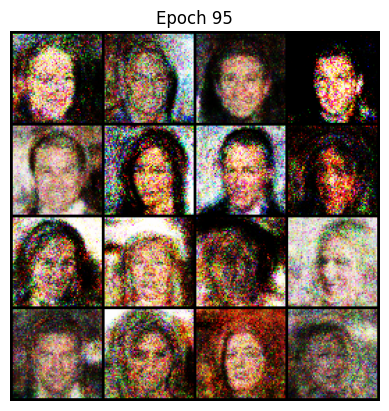

[Epoch 96/100] [Batch 0/1583] [D loss: 0.5346893072128296] [G loss: 1.543243169784546]
[Epoch 96/100] [Batch 50/1583] [D loss: 0.543895959854126] [G loss: 1.3844549655914307]
[Epoch 96/100] [Batch 100/1583] [D loss: 0.48526906967163086] [G loss: 1.538088321685791]
[Epoch 96/100] [Batch 150/1583] [D loss: 0.5539630651473999] [G loss: 1.2039333581924438]
[Epoch 96/100] [Batch 200/1583] [D loss: 0.5170575380325317] [G loss: 1.3560909032821655]
[Epoch 96/100] [Batch 250/1583] [D loss: 0.4946112632751465] [G loss: 1.255979061126709]
[Epoch 96/100] [Batch 300/1583] [D loss: 0.5254245400428772] [G loss: 1.4240856170654297]
[Epoch 96/100] [Batch 350/1583] [D loss: 0.4942677319049835] [G loss: 1.275292992591858]
[Epoch 96/100] [Batch 400/1583] [D loss: 0.4415411949157715] [G loss: 1.695911169052124]
[Epoch 96/100] [Batch 450/1583] [D loss: 0.4758163094520569] [G loss: 1.5037459135055542]
[Epoch 96/100] [Batch 500/1583] [D loss: 0.47144055366516113] [G loss: 1.3660626411437988]
[Epoch 96/100] [B

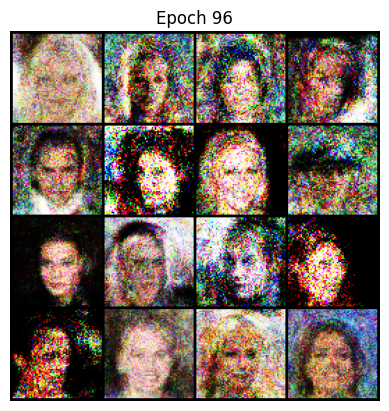

[Epoch 97/100] [Batch 0/1583] [D loss: 0.4802020192146301] [G loss: 1.5563209056854248]
[Epoch 97/100] [Batch 50/1583] [D loss: 0.4879147410392761] [G loss: 1.2952778339385986]
[Epoch 97/100] [Batch 100/1583] [D loss: 0.46920639276504517] [G loss: 1.2041311264038086]
[Epoch 97/100] [Batch 150/1583] [D loss: 0.4924721121788025] [G loss: 1.5851119756698608]
[Epoch 97/100] [Batch 200/1583] [D loss: 0.4399261474609375] [G loss: 1.5194610357284546]
[Epoch 97/100] [Batch 250/1583] [D loss: 0.4302569329738617] [G loss: 1.4203550815582275]
[Epoch 97/100] [Batch 300/1583] [D loss: 0.5782419443130493] [G loss: 1.6911629438400269]
[Epoch 97/100] [Batch 350/1583] [D loss: 0.4756873846054077] [G loss: 1.5439082384109497]
[Epoch 97/100] [Batch 400/1583] [D loss: 0.4901631474494934] [G loss: 1.275278925895691]
[Epoch 97/100] [Batch 450/1583] [D loss: 0.48521193861961365] [G loss: 1.244572401046753]
[Epoch 97/100] [Batch 500/1583] [D loss: 0.47062093019485474] [G loss: 1.44781494140625]
[Epoch 97/100]

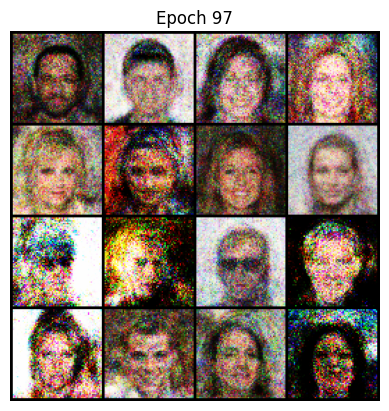

[Epoch 98/100] [Batch 0/1583] [D loss: 0.5074307322502136] [G loss: 1.5886070728302002]
[Epoch 98/100] [Batch 50/1583] [D loss: 0.42875200510025024] [G loss: 1.2441604137420654]
[Epoch 98/100] [Batch 100/1583] [D loss: 0.4721525013446808] [G loss: 1.4381883144378662]
[Epoch 98/100] [Batch 150/1583] [D loss: 0.493093878030777] [G loss: 1.4549627304077148]
[Epoch 98/100] [Batch 200/1583] [D loss: 0.4965289235115051] [G loss: 1.4710537195205688]
[Epoch 98/100] [Batch 250/1583] [D loss: 0.4620080292224884] [G loss: 1.380490779876709]
[Epoch 98/100] [Batch 300/1583] [D loss: 0.5474824905395508] [G loss: 1.4255876541137695]
[Epoch 98/100] [Batch 350/1583] [D loss: 0.47350525856018066] [G loss: 1.3740381002426147]
[Epoch 98/100] [Batch 400/1583] [D loss: 0.47904032468795776] [G loss: 1.3207249641418457]
[Epoch 98/100] [Batch 450/1583] [D loss: 0.5350501537322998] [G loss: 1.469897985458374]
[Epoch 98/100] [Batch 500/1583] [D loss: 0.4993249177932739] [G loss: 1.5086452960968018]
[Epoch 98/100

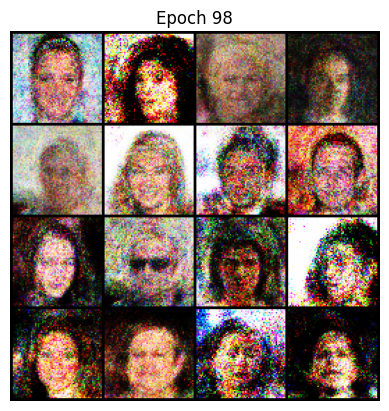

[Epoch 99/100] [Batch 0/1583] [D loss: 0.5102487802505493] [G loss: 1.3377232551574707]
[Epoch 99/100] [Batch 50/1583] [D loss: 0.515370786190033] [G loss: 1.2850292921066284]
[Epoch 99/100] [Batch 100/1583] [D loss: 0.5002449750900269] [G loss: 1.5634069442749023]
[Epoch 99/100] [Batch 150/1583] [D loss: 0.522325336933136] [G loss: 1.4578346014022827]
[Epoch 99/100] [Batch 200/1583] [D loss: 0.5138059854507446] [G loss: 1.3472914695739746]
[Epoch 99/100] [Batch 250/1583] [D loss: 0.45443522930145264] [G loss: 1.1659982204437256]
[Epoch 99/100] [Batch 300/1583] [D loss: 0.5774570107460022] [G loss: 1.4615390300750732]
[Epoch 99/100] [Batch 350/1583] [D loss: 0.508704423904419] [G loss: 1.388245940208435]
[Epoch 99/100] [Batch 400/1583] [D loss: 0.5122432708740234] [G loss: 1.6431496143341064]
[Epoch 99/100] [Batch 450/1583] [D loss: 0.4962899684906006] [G loss: 1.6556137800216675]
[Epoch 99/100] [Batch 500/1583] [D loss: 0.5202869176864624] [G loss: 1.440300703048706]
[Epoch 99/100] [B

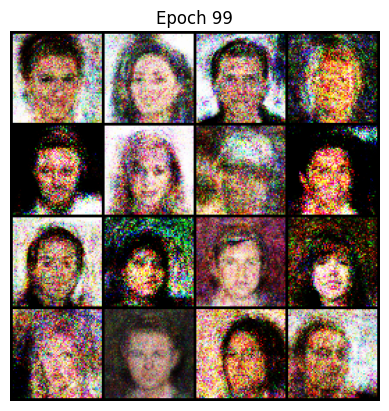

In [8]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms
import matplotlib.pyplot as plt
import os
from PIL import Image
import torchvision
import numpy as np


# Generator and Discriminator classes (same as previously described)
class Generator(nn.Module):
    def __init__(self, z_dim=100, img_channels=3):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(z_dim, 256),
            nn.ReLU(True),
            nn.Linear(256, 512),
            nn.ReLU(True),
            nn.Linear(512, 1024),
            nn.ReLU(True),
            nn.Linear(1024, img_channels * 64 * 64),
            nn.Tanh()
        )

    def forward(self, z):
        img = self.model(z)
        img = img.view(img.size(0), 3, 64, 64)  # Reshape to image format
        return img

class Discriminator(nn.Module):
    def __init__(self, img_channels=3):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Flatten(),
            nn.Linear(img_channels * 64 * 64, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img):
        return self.model(img)

# Loss function and optimizers
adversarial_loss = nn.BCELoss()
generator = Generator(z_dim=100)
discriminator = Discriminator()
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Define device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
generator = generator.to(device)
discriminator = discriminator.to(device)

# Training loop
def train(generator, discriminator, dataloader, epochs=5):
    for epoch in range(epochs):
        for i, imgs in enumerate(dataloader):
            real_imgs = imgs.to(device)
            batch_size = real_imgs.size(0)
            valid = torch.ones(batch_size, 1).to(device)
            fake = torch.zeros(batch_size, 1).to(device)

            # Train Discriminator
            optimizer_D.zero_grad()
            real_loss = adversarial_loss(discriminator(real_imgs), valid)
            fake_loss = adversarial_loss(discriminator(generator(torch.randn(batch_size, 100).to(device)).detach()), fake)
            d_loss = (real_loss + fake_loss) / 2
            d_loss.backward()
            optimizer_D.step()

            # Train Generator
            optimizer_G.zero_grad()
            g_loss = adversarial_loss(discriminator(generator(torch.randn(batch_size, 100).to(device))), valid)
            g_loss.backward()
            optimizer_G.step()

            if i % 50 == 0:
                print(f"[Epoch {epoch}/{epochs}] [Batch {i}/{len(dataloader)}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}]")

        # Optionally, save generated images at each epoch
        save_generated_images(generator, epoch, device)

def save_generated_images(generator, epoch, device, num_images=16):
    z = torch.randn(num_images, 100).to(device)
    generated_imgs = generator(z).detach().cpu()
    grid = torchvision.utils.make_grid(generated_imgs, nrow=4, normalize=True)
    plt.imshow(np.transpose(grid, (1, 2, 0)))
    plt.title(f"Epoch {epoch}")
    plt.axis('off')
    plt.show()

# Start training
train(generator, discriminator, dataloader, epochs= 100)
